In [ ]:
import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import scipy
import preprocessing
import pandas as pd
from cmdstanpy import CmdStanModel
import nest_asyncio
import seaborn as sns
import itertools

from matplotlib.lines import Line2D

In [ ]:
def circular_inference(prior, left_like,right_like,param):

    pa1 = param[0]/2 + 0.5
    pa2 = param[1]/2 + 0.5
    pa3 = param[2]
    pa4 = param[3]

    #prior logit
    Cp = prior
    Fp = 1 - prior
    Lp = np.log(Cp/Fp)
    aplp = pa3*Lp
    Faplpwp = l_w(aplp,pa1)

    #likelihood logit
    Li_le = left_like
    Li_ri = right_like
    Ls = np.log(Li_le/Li_ri) 
    asls = pa4*Ls
    Faslsws = l_w(asls,pa2)

    Lc = l_w(Ls+Faplpwp+Faslsws,pa2) + l_w(Lp+Faslsws+Faplpwp,pa1)
    pred_c = np.exp(Lc)/(1+np.exp(Lc))# + np.random.uniform(low=-0.1, high=0.1)

    pred_c = np.clip(pred_c,0.018,0.982)
    
    return pred_c

def l_w(L,w):
    f = np.log((w*np.exp(L)+1-w) / ((1-w)*np.exp(L)+w))
    return f

def compute_BIC(actual_c,prior,left_likelihood,right_likelihood,params,k):
    n=100
    pred_c = np.zeros(n)
    sigma_squared = 0
    
    for t in range(n):
        pred_c[t] = circular_inference(prior[t],left_likelihood[t],right_likelihood[t],params)
        sigma_squared += (pred_c[t] - actual_c[t])**2 #mean-squared-difference
    bic = n*np.log(sigma_squared) + k*np.log(n)
    return bic, sigma_squared

In [3]:
stan_model_weighted =  """
functions {
    real l_w(real l, real w) {
        real f;
        f = log((w*exp(l)+1-w) / ((1-w)*exp(l)+w));
        return f;
    }
}


data {
    int T;
    vector<lower=0>[T] prior;
    vector<lower=0>[T] left_likelihood;
    vector<lower=0>[T] right_likelihood;
    vector<lower=0>[T] confidence;
    real scale_p;
    real scale_s;
}

parameters {
    real<lower=0,upper=1> wp;
    real<lower=0,upper=1> ws;
}

transformed parameters {
    real <lower=0> scaled_wp;
    real <lower=0> scaled_ws;
    scaled_wp = wp/2 + 0.5;
    scaled_ws = ws/2 + 0.5;
}

model {
    array[T] real lp;;
    array[T] real aplp;
    array[T] real Faplpwp;
    array[T] real ls;
    array[T] real asls;
    array[T] real Faslsws;
    array[T] real lc;
    array[T] real pred_c;
    array[T] real lprob;
    array[T] real lpred;

    wp ~ beta(2,2);
    ws ~ beta(2,2);
    real alpha_p = 0;
    real alpha_s = 0;

    for (t in 1:T){
    
        lp[t] = log(prior[t]/(1-prior[t]));
        aplp[t] = alpha_p*lp[t];
        Faplpwp[t] = l_w(aplp[t],scaled_wp);

        ls[t] = log(left_likelihood[t]/right_likelihood[t]);
        asls[t] = alpha_s*ls[t];
        Faslsws[t] = l_w(asls[t],scaled_ws);

        lc[t] = l_w(ls[t]+Faplpwp[t]+Faslsws[t], scaled_ws) + l_w(lp[t]+Faplpwp[t]+Faslsws[t], scaled_wp);
        pred_c[t] = exp(lc[t])/(1+exp(lc[t]));

        if (pred_c[t] > 0.982) {
            pred_c[t] = 0.982;
        }
        else if (pred_c[t] < 0.018) {
            pred_c[t] = 0.018;
        }

        lpred[t] = log(pred_c[t]/(1-pred_c[t]));
        lprob[t] = log(confidence[t]/(1-confidence[t]));

        target += -(lprob[t] - lpred[t])^2;
    }
}

generated quantities {
    vector[T] log_lik;

    for (t in 1:T) {
        real lp = log(prior[t] / (1 - prior[t]));
        real aplp = 0 * lp; 
        real Faplpwp = l_w(aplp, wp / 2 + 0.5);

        real ls = log(left_likelihood[t] / right_likelihood[t]);
        real asls = 0 * ls; 
        real Faslsws = l_w(asls, ws / 2 + 0.5);

        real lc = l_w(ls + Faplpwp + Faslsws, ws / 2 + 0.5) + 
                  l_w(lp + Faplpwp + Faslsws, wp / 2 + 0.5);
        real pred_c = exp(lc) / (1 + exp(lc));

        if (pred_c > 0.982) {
            pred_c = 0.982;
        } else if (pred_c < 0.018) {
            pred_c = 0.018;
        }

        real lpred = log(pred_c / (1 - pred_c));
        real lprob = log(confidence[t] / (1 - confidence[t]));

        log_lik[t] = -(lprob - lpred)^2;
    }
}

"""

stan_model_alpha =  """
functions {
    real l_w(real l, real w) {
        real f;
        f = log((w*exp(l)+1-w) / ((1-w)*exp(l)+w));
        return f;
    }
}


data {
    int T;
    vector<lower=0>[T] prior;
    vector<lower=0>[T] left_likelihood;
    vector<lower=0>[T] right_likelihood;
    vector<lower=0>[T] confidence;
    real scale_p;
    real scale_s;
}

parameters {
    real<lower=0,upper=1> alpha_p;
    real<lower=0,upper=1> alpha_s;
}

transformed parameters {
    real <lower=0> scaled_alpha_p;
    real <lower=0> scaled_alpha_s;
    scaled_alpha_p = alpha_p*scale_p;
    scaled_alpha_s = alpha_s*scale_s;
}

model {
    array[T] real lp;;
    array[T] real aplp;
    array[T] real Faplpwp;
    array[T] real ls;
    array[T] real asls;
    array[T] real Faslsws;
    array[T] real lc;
    array[T] real pred_c;
    array[T] real lprob;
    array[T] real lpred;

    real wp = 1;
    real ws = 1;


    alpha_p ~ beta(1,15);
    alpha_s ~ beta(1,15);



    for (t in 1:T){
    
        lp[t] = log(prior[t]/(1-prior[t]));
        aplp[t] = scaled_alpha_p*lp[t];
        Faplpwp[t] = l_w(aplp[t],wp);

        ls[t] = log(left_likelihood[t]/right_likelihood[t]);
        asls[t] = scaled_alpha_s*ls[t];
        Faslsws[t] = l_w(asls[t],ws);

        lc[t] = l_w(ls[t]+Faplpwp[t]+Faslsws[t], ws) + l_w(lp[t]+Faplpwp[t]+Faslsws[t], wp);
        pred_c[t] = exp(lc[t])/(1+exp(lc[t]));

        if (pred_c[t] > 0.982) {
            pred_c[t] = 0.982;
        }
        else if (pred_c[t] < 0.018) {
            pred_c[t] = 0.018;
        }

        lpred[t] = log(pred_c[t]/(1-pred_c[t]));
        lprob[t] = log(confidence[t]/(1-confidence[t]));

        target += -(lprob[t] - lpred[t])^2;
    }
}

generated quantities {
    vector[T] log_lik;

    for (t in 1:T) {
        real scaled_wp = 1 / 2 + 0.5;
        real scaled_ws = 1 / 2 + 0.5;

        real lp = log(prior[t] / (1 - prior[t]));
        real aplp = scaled_alpha_p * lp;
        real Faplpwp = l_w(aplp, scaled_wp);

        real ls = log(left_likelihood[t] / right_likelihood[t]);
        real asls = scaled_alpha_s * ls;
        real Faslsws = l_w(asls, scaled_ws);

        real lc = l_w(ls + Faplpwp + Faslsws, scaled_ws) +
                  l_w(lp + Faplpwp + Faslsws, scaled_wp);
        real pred_c = exp(lc) / (1 + exp(lc));

        // Constrain pred_c to the valid range
        if (pred_c > 0.982) {
            pred_c = 0.982;
        } else if (pred_c < 0.018) {
            pred_c = 0.018;
        }

        // Compute lpred and lprob
        real lpred = log(pred_c / (1 - pred_c));
        real lprob = log(confidence[t] / (1 - confidence[t]));

        // Calculate the log likelihood
        log_lik[t] = -(lprob - lpred)^2;
    }
}

"""

stan_model_circular =  """
functions {
    real l_w(real l, real w) {
        real f;
        f = log((w*exp(l)+1-w) / ((1-w)*exp(l)+w));
        return f;
    }
}


data {
    int T;
    vector<lower=0>[T] prior;
    vector<lower=0>[T] left_likelihood;
    vector<lower=0>[T] right_likelihood;
    vector<lower=0>[T] confidence;
    real scale_p;
    real scale_s;
}

parameters {
    real<lower=0,upper=1> wp;
    real<lower=0,upper=1> ws;
    real<lower=0,upper=1> alpha_p;
    real<lower=0,upper=1> alpha_s;
}

transformed parameters {
    real <lower=0> scaled_wp;
    real <lower=0> scaled_ws;
    scaled_wp = wp/2 + 0.5;
    scaled_ws = ws/2 + 0.5;

    real <lower=0> scaled_alpha_p;
    real <lower=0> scaled_alpha_s;
    scaled_alpha_p = alpha_p*scale_p;
    scaled_alpha_s = alpha_s*scale_s;
}

model {
    array[T] real lp;;
    array[T] real aplp;
    array[T] real Faplpwp;
    array[T] real ls;
    array[T] real asls;
    array[T] real Faslsws;
    array[T] real lc;
    array[T] real pred_c;
    array[T] real lprob;
    array[T] real lpred;

    wp ~ beta(2,2);
    ws ~ beta(2,2);
    alpha_p ~ beta(1,15);
    alpha_s ~ beta(1,15);

    for (t in 1:T){
    
        lp[t] = log(prior[t]/(1-prior[t]));
        aplp[t] = scaled_alpha_p*lp[t];
        Faplpwp[t] = l_w(aplp[t],scaled_wp);

        ls[t] = log(left_likelihood[t]/right_likelihood[t]);
        asls[t] = scaled_alpha_s*ls[t];
        Faslsws[t] = l_w(asls[t],scaled_ws);

        lc[t] = l_w(ls[t]+Faplpwp[t]+Faslsws[t], scaled_ws) + l_w(lp[t]+Faplpwp[t]+Faslsws[t], scaled_wp);
        pred_c[t] = exp(lc[t])/(1+exp(lc[t]));

        if (pred_c[t] > 0.982) {
            pred_c[t] = 0.982;
        }
        else if (pred_c[t] < 0.018) {
            pred_c[t] = 0.018;
        }

        lpred[t] = log(pred_c[t]/(1-pred_c[t]));
        lprob[t] = log(confidence[t]/(1-confidence[t]));

        target += -(lprob[t] - lpred[t])^2;
    }
}

generated quantities {
    vector[T] log_lik;

    for (t in 1:T) {
        real gq_scaled_wp = wp / 2 + 0.5; // Renamed variable
        real gq_scaled_ws = ws / 2 + 0.5; // Renamed variable
        real gq_scaled_alpha_p = alpha_p * scale_p; // Renamed variable
        real gq_scaled_alpha_s = alpha_s * scale_s; // Renamed variable

        // Compute intermediate values
        real lp = log(prior[t] / (1 - prior[t]));
        real aplp = gq_scaled_alpha_p * lp;
        real Faplpwp = l_w(aplp, gq_scaled_wp);

        real ls = log(left_likelihood[t] / right_likelihood[t]);
        real asls = gq_scaled_alpha_s * ls;
        real Faslsws = l_w(asls, gq_scaled_ws);

        real lc = l_w(ls + Faplpwp + Faslsws, gq_scaled_ws) +
                  l_w(lp + Faplpwp + Faslsws, gq_scaled_wp);
        real pred_c = exp(lc) / (1 + exp(lc));

        // Constrain pred_c to the valid range
        if (pred_c > 0.982) {
            pred_c = 0.982;
        } else if (pred_c < 0.018) {
            pred_c = 0.018;
        }

        // Compute log likelihood
        real lpred = log(pred_c / (1 - pred_c));
        real lprob = log(confidence[t] / (1 - confidence[t]));
        log_lik[t] = -(lprob - lpred)^2;
    }
}

"""
nest_asyncio.apply()

with open("model_weighted.stan", "w") as f:
    f.write(stan_model_weighted)

with open("model_alpha.stan", "w") as f:
    f.write(stan_model_alpha)

with open("model_circular.stan", "w") as f:
    f.write(stan_model_circular)


In [ ]:
data, iamge_data = preprocessing.preprocess()

# Change the likelihood value 
likelihood_dir='path_to_likelihood/online_likelihood.csv'
like_data = pd.read_csv(likelihood_dir)

for i in range(1,101):
    data.loc[data['imgseq']==i,'correct_image'] = like_data.loc[like_data['im_number']==i,'categ1_ave'].values[0]
    data.loc[data['imgseq']==i,'false_image'] = like_data.loc[like_data['im_number']==i,'categ2_ave'].values[0]

In [ ]:
sub_list = []
allsub = []
scz = []
con = []
number_sub = 21
sigma = 0

scale_p=10
scale_s=10

rng = np.random.default_rng(666)

estimated_wp = np.zeros(number_sub)
estimated_ws = np.zeros(number_sub)
estimated_alpha_p = np.zeros(number_sub)
estimated_alpha_s = np.zeros(number_sub)

parameters_mean = {
    'wp': estimated_wp,
    'ws': estimated_ws,
    'alpha_p': estimated_alpha_p,
    'alpha_s': estimated_alpha_s
}


weighted_matrix = pd.DataFrame(np.zeros((21,2)), index=range(21), columns=['wp','ws'])
alpha_matrix = pd.DataFrame(np.zeros((21,2)), index=range(21), columns=['alpha_p','alpha_s'])
circular_matrix = pd.DataFrame(np.zeros((21,4)), index=range(21), columns=['wp','ws','alpha_p','alpha_s'])


models = ['Simple','Weighted','Alpha','Circular']
bic_matrix = pd.DataFrame(np.zeros((21,4)), index=range(21), columns=models)
sigma_matrix = pd.DataFrame(np.zeros((21,4)), index=range(21), columns=models)

22:28:36 - cmdstanpy - INFO - CmdStan start processing


0


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 1 |█████▊       


22:28:39 - cmdstanpy - INFO - CmdStan done processing.


22:28:39 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteratio


22:28:42 - cmdstanpy - INFO - CmdStan done processing.


22:28:42 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▍                    | 00:00 Iterati


22:28:49 - cmdstanpy - INFO - CmdStan done processing.


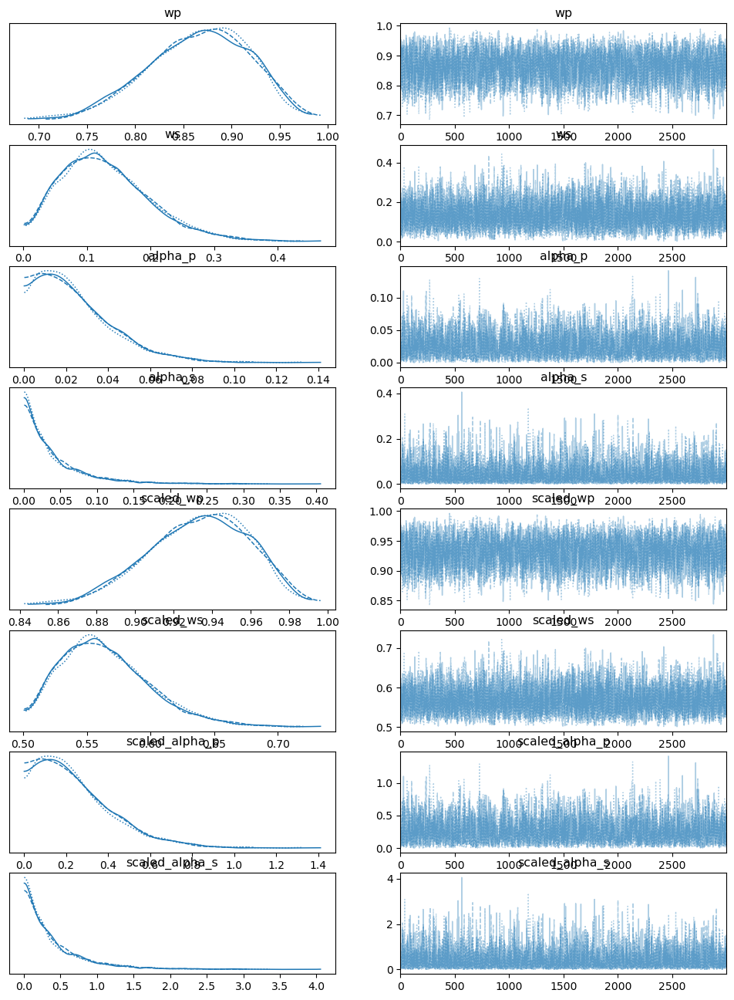

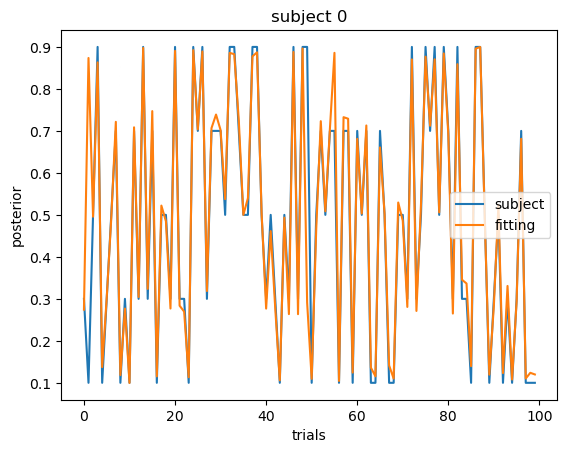

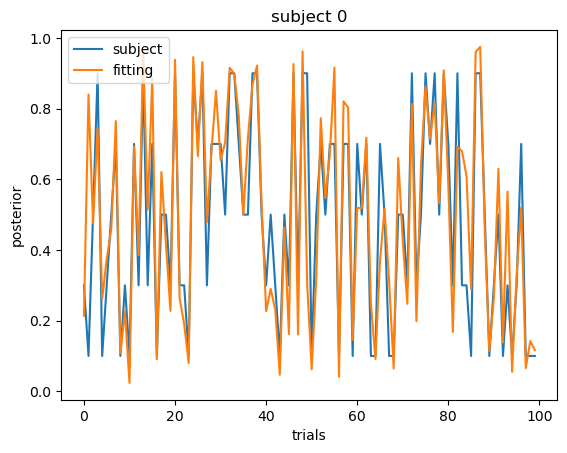

22:28:50 - cmdstanpy - INFO - CmdStan start processing


1


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 1 |█████                   | 00:00 Iteration: 1100 / 6000 [ 18%]  (Warmup)

chain 3 |█████▍                  | 00:00 Iteration: 1200 / 6000 [ 20%]  (Warmup)
chain 1 |██████▌                 | 00:00 Iteration: 1500 / 6000 [ 25%]  (Warmup)

chain 3 |██████▉                 | 00:00 Iteration: 1600 / 6000 [ 26%]  (Warmup)
chain 1 |████████▏    


22:28:52 - cmdstanpy - INFO - CmdStan done processing.


22:28:52 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |████▎                   | 00:00 Iteration:  900 / 6000 [ 15%]  (Warmup)
chain 2 |████▎                   | 00:00 Iteration:  900 / 6000 [ 15%]  (Warmup)

chain 1 |█████▍                  | 00:00 Iterati


22:28:56 - cmdstanpy - INFO - CmdStan done processing.


22:28:56 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███▊                    | 00:00 Iteratio


22:29:01 - cmdstanpy - INFO - CmdStan done processing.


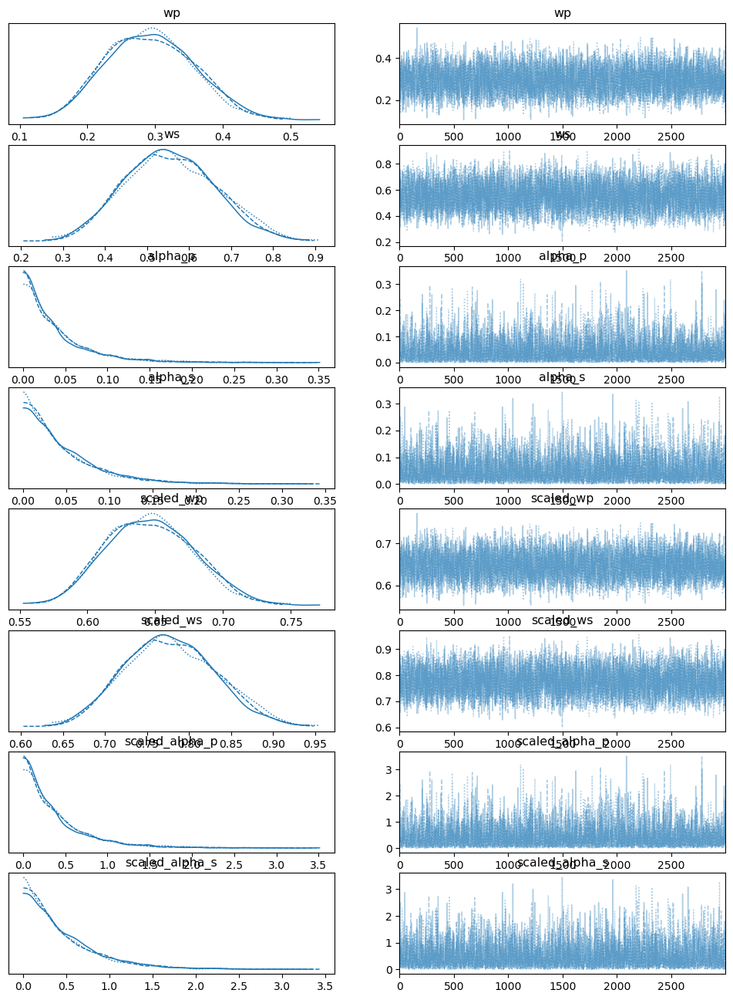

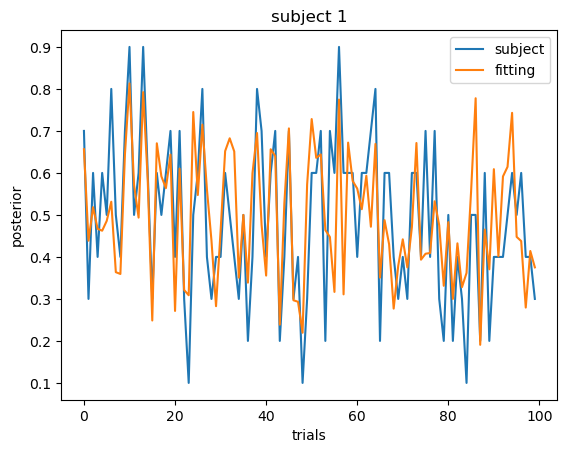

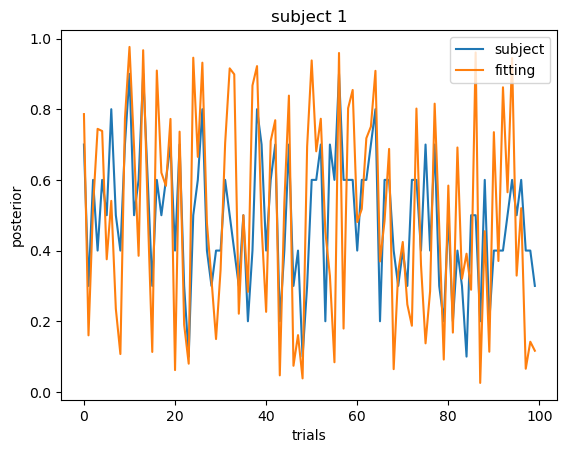

22:29:03 - cmdstanpy - INFO - CmdStan start processing


2


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |█████                   | 00:00 Iteration: 1100 / 6000 [ 18%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |██████▏                 | 00:00 Iteration: 1400 / 6000 [ 23%]  (Warmup)
chain 1 |██████▏      


22:29:05 - cmdstanpy - INFO - CmdStan done processing.


22:29:05 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 1 |████▎                   | 00:00 Iteration:  900 / 6000 [ 15%]  (Warmup)
chain 2 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 1 |█████                   | 00:00 Iterati


22:29:09 - cmdstanpy - INFO - CmdStan done processing.


22:29:10 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 1 |███▊                    | 00:00 Iteratio


22:29:16 - cmdstanpy - INFO - CmdStan done processing.


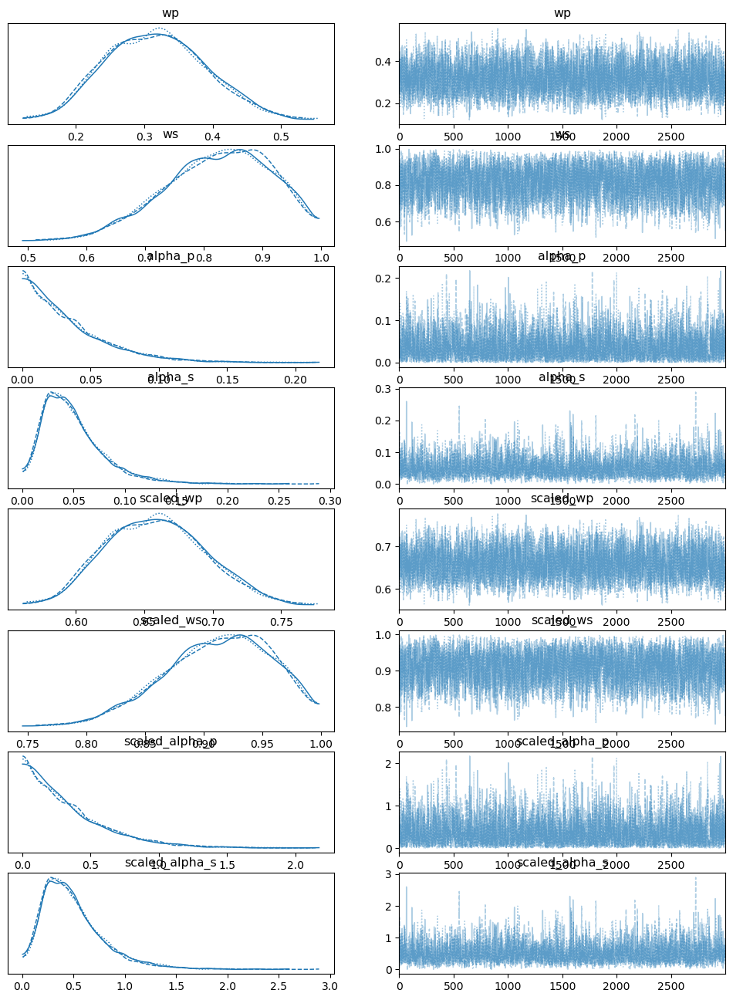

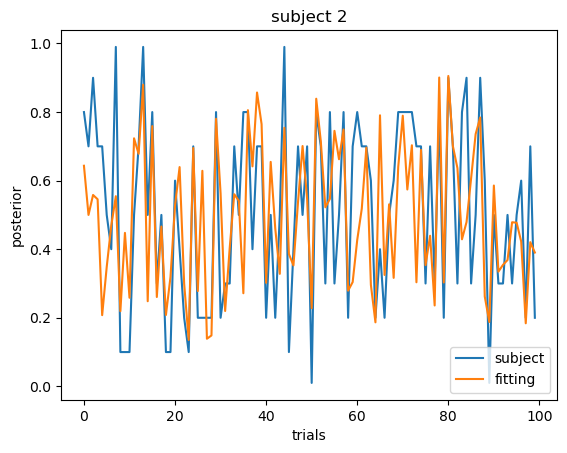

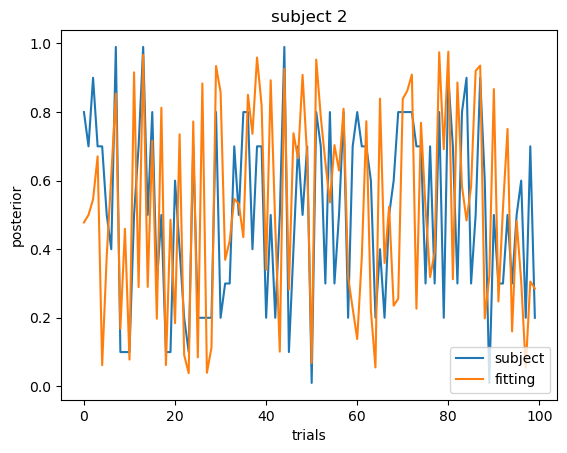

22:29:17 - cmdstanpy - INFO - CmdStan start processing


3


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |█████                   | 00:00 Iteration: 1100 / 6000 [ 18%]  (Warmup)
chain 2 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 1 |██████▏      


22:29:20 - cmdstanpy - INFO - CmdStan done processing.


22:29:20 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 1 |███▊                    | 00:00 Iteratio


22:29:23 - cmdstanpy - INFO - CmdStan done processing.


22:29:23 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 2 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 1 |████▋                   | 00:00 Iteratio


22:29:27 - cmdstanpy - INFO - CmdStan done processing.


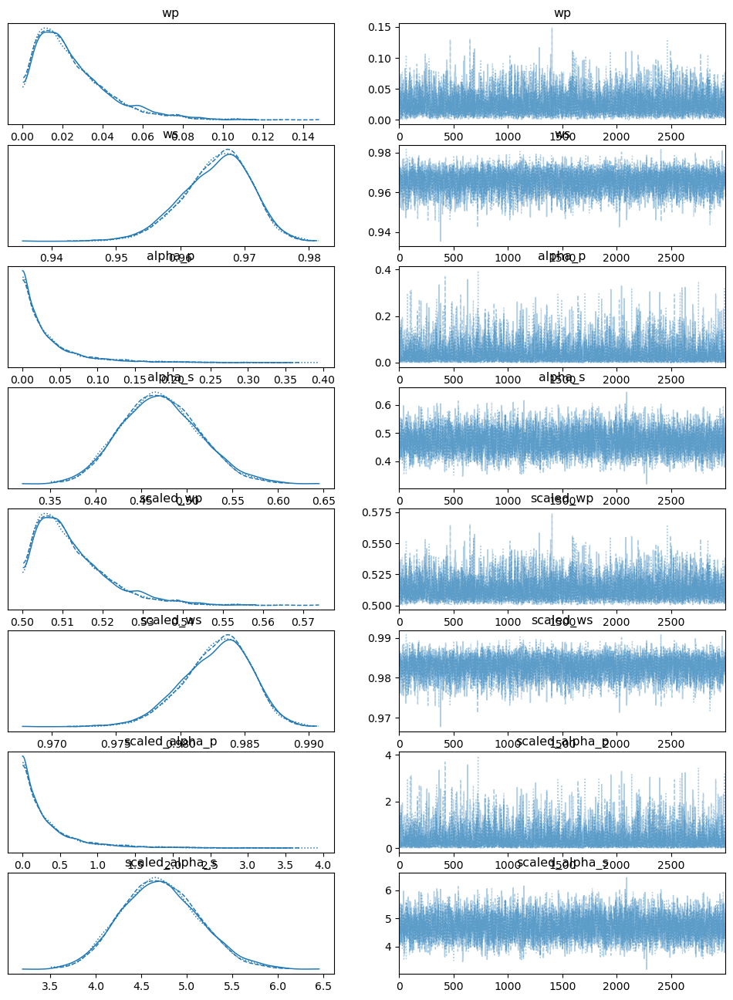

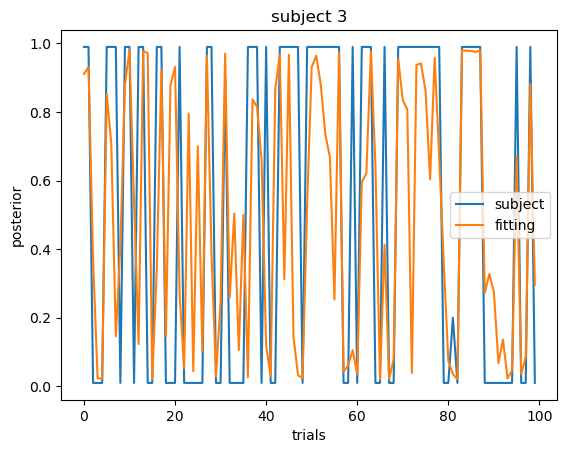

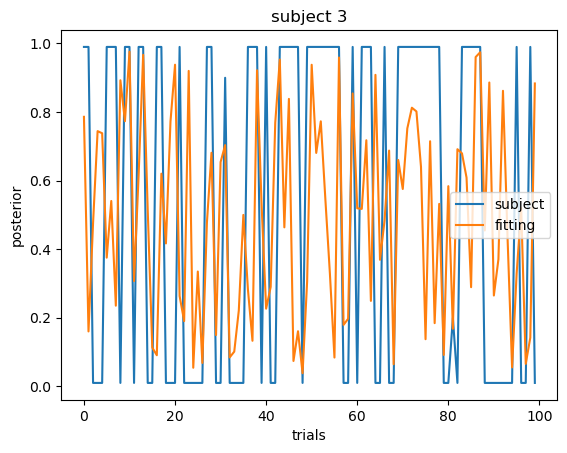

22:29:28 - cmdstanpy - INFO - CmdStan start processing


4


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 2 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 1 |██████▏      


22:29:31 - cmdstanpy - INFO - CmdStan done processing.


22:29:31 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteratio


22:29:34 - cmdstanpy - INFO - CmdStan done processing.


22:29:35 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 3 |███▍                    | 00:00 Iterati


22:29:41 - cmdstanpy - INFO - CmdStan done processing.


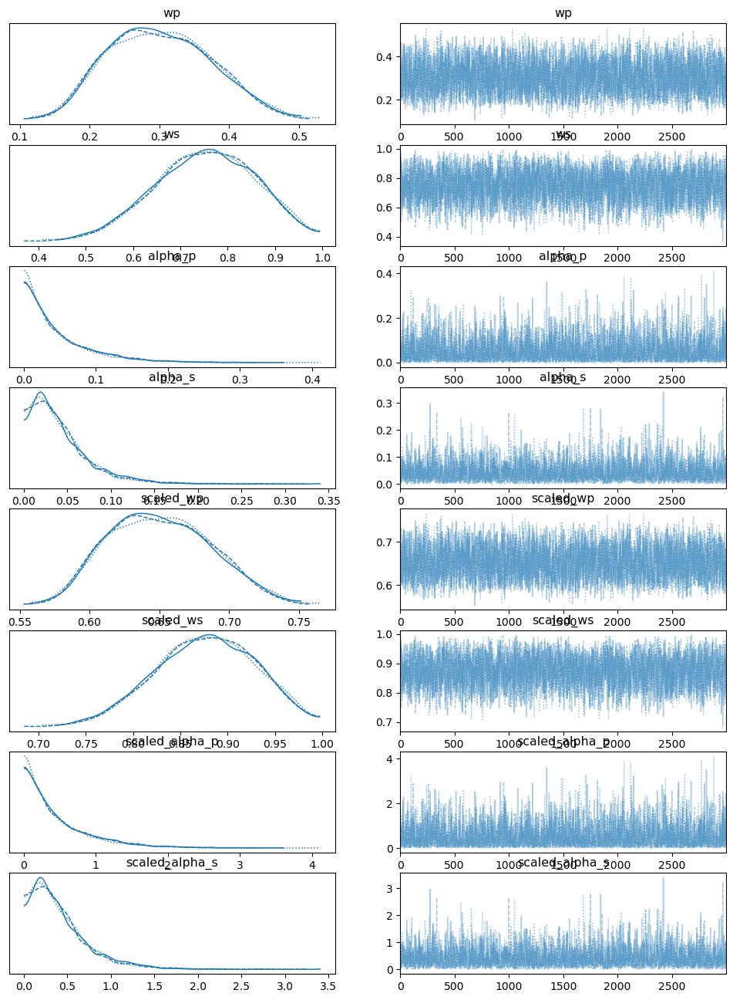

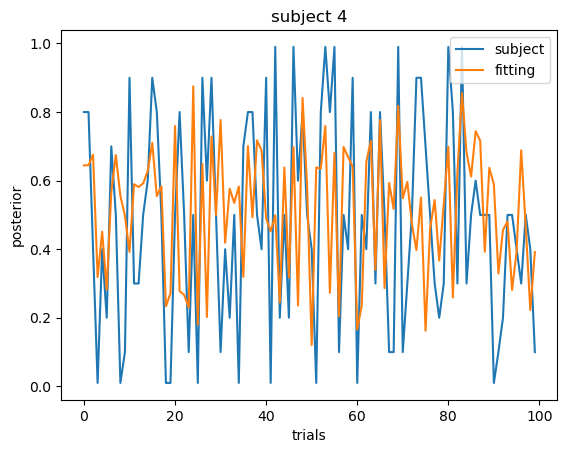

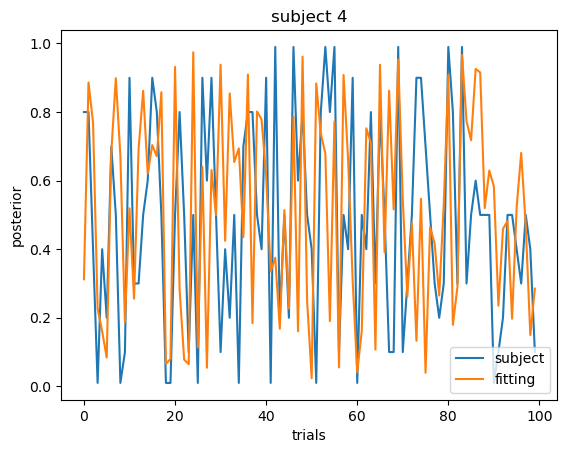

22:29:42 - cmdstanpy - INFO - CmdStan start processing


5


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 3 |█████▊       


22:29:45 - cmdstanpy - INFO - CmdStan done processing.


22:29:45 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 1 |████▋                   | 00:00 Iterati


22:29:48 - cmdstanpy - INFO - CmdStan done processing.


22:29:49 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 3 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iterati


22:29:55 - cmdstanpy - INFO - CmdStan done processing.


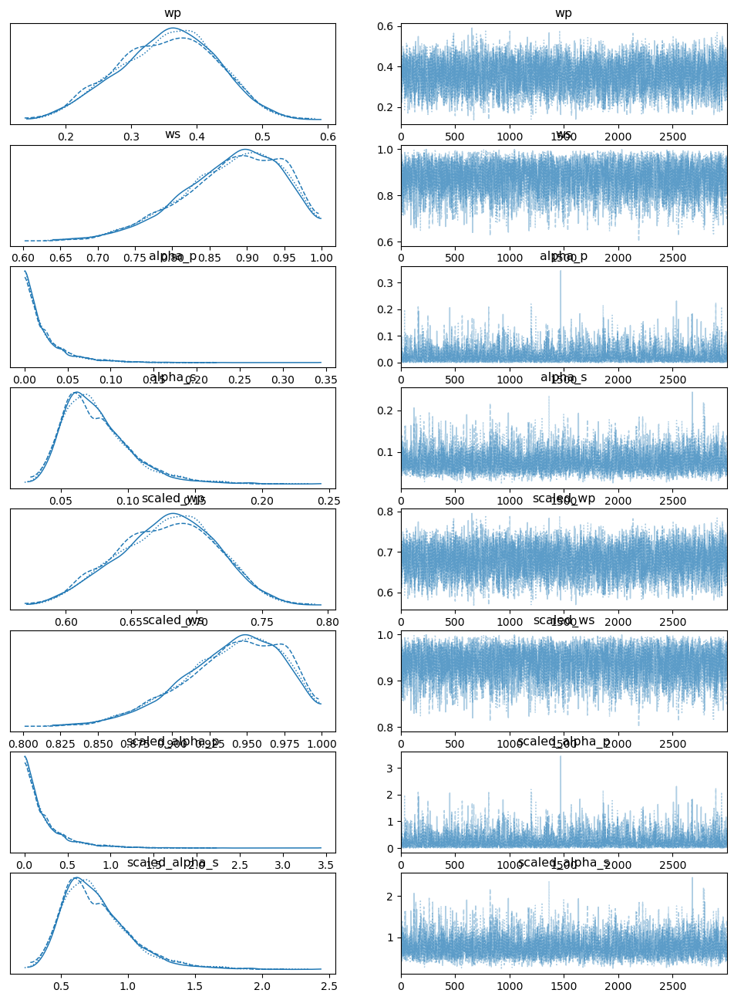

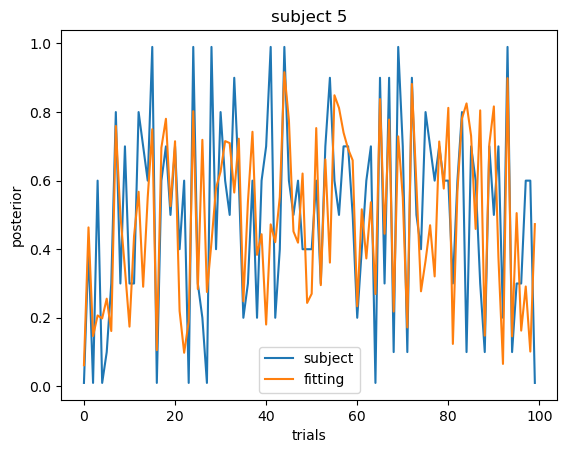

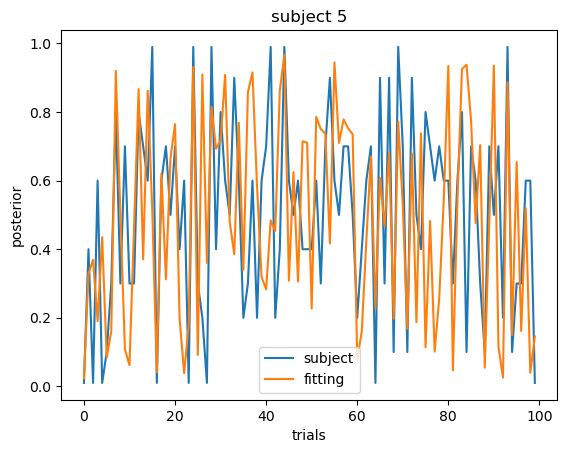

22:29:56 - cmdstanpy - INFO - CmdStan start processing


6


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 3 |█████▊       


22:29:59 - cmdstanpy - INFO - CmdStan done processing.


22:29:59 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |█████▊                  | 00:00 Iterati


22:30:02 - cmdstanpy - INFO - CmdStan done processing.


22:30:03 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 3 |███▊                    | 00:00 Iterati


22:30:08 - cmdstanpy - INFO - CmdStan done processing.


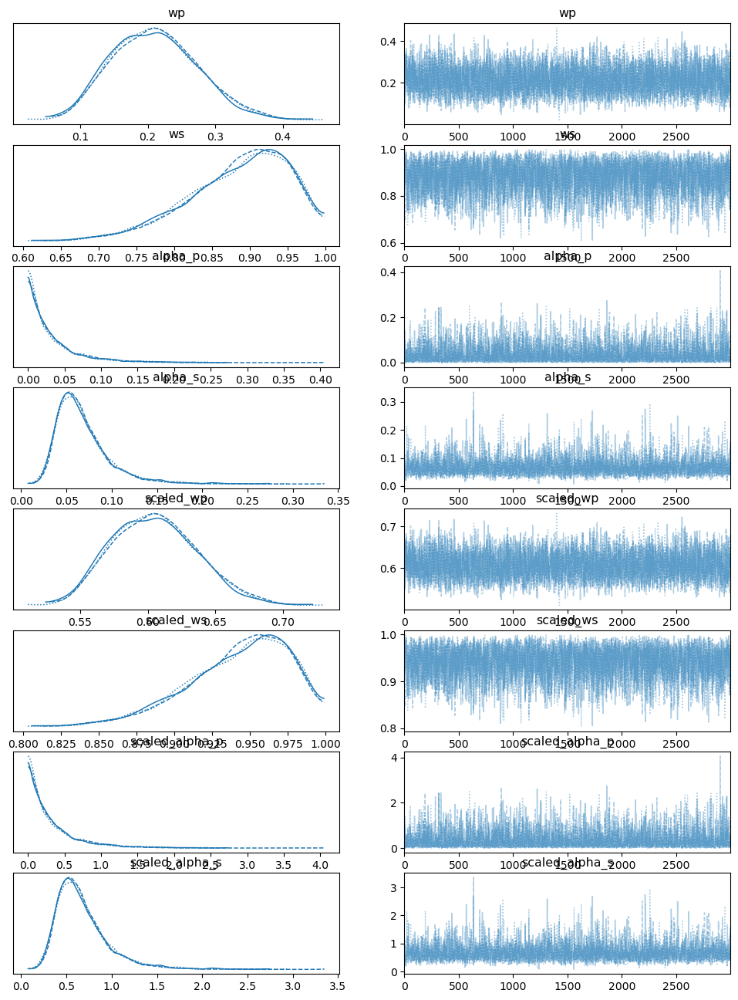

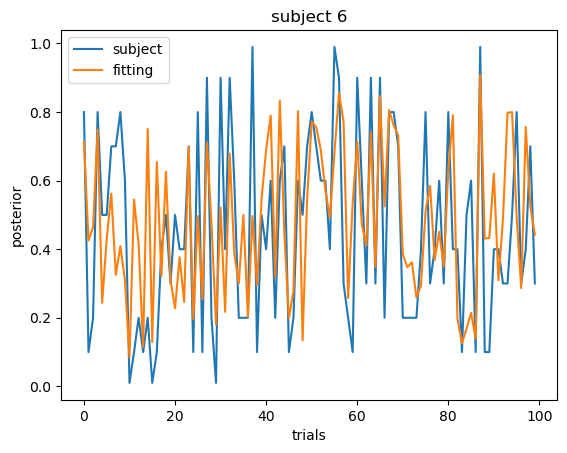

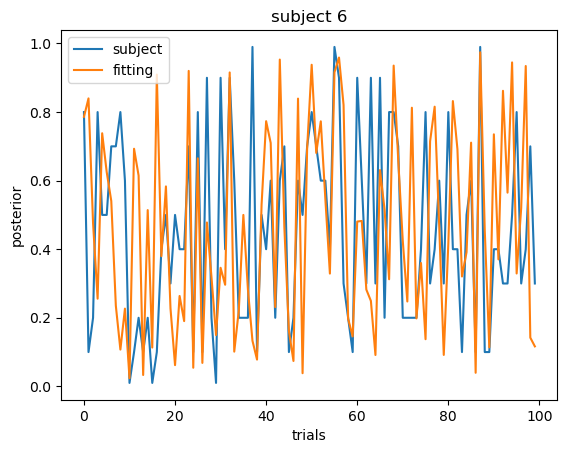

22:30:10 - cmdstanpy - INFO - CmdStan start processing


7


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 3 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 1 |██████▉      

22:30:12 - cmdstanpy - INFO - CmdStan done processing.


22:30:13 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteratio


22:30:16 - cmdstanpy - INFO - CmdStan done processing.


22:30:16 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |███▊                    | 00:00 Iterati


22:30:21 - cmdstanpy - INFO - CmdStan done processing.


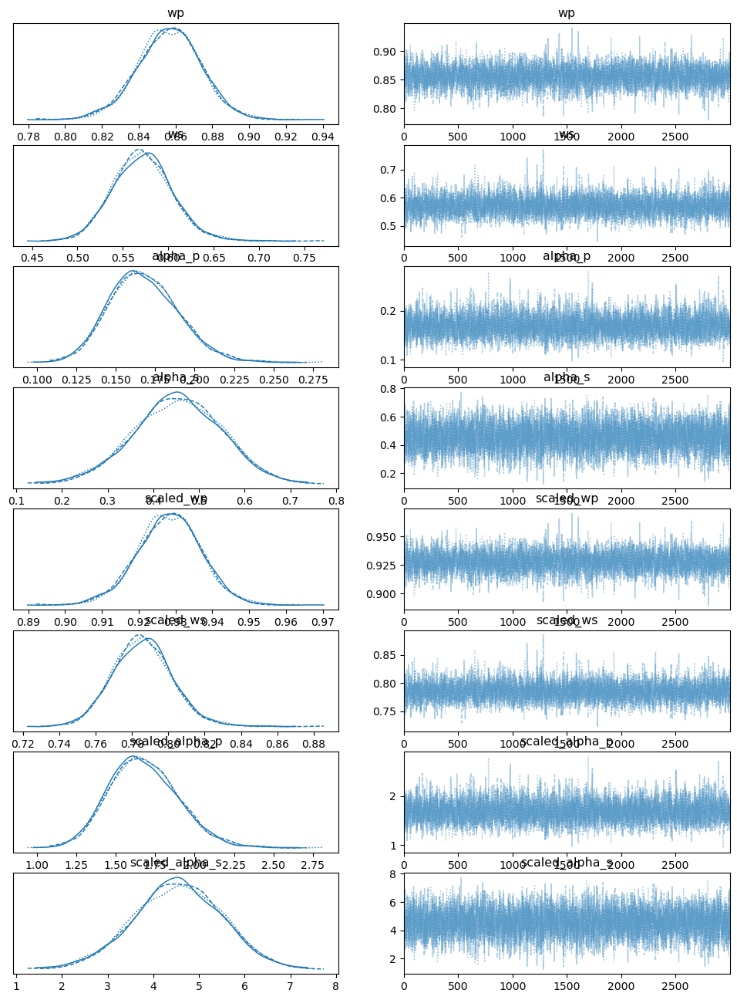

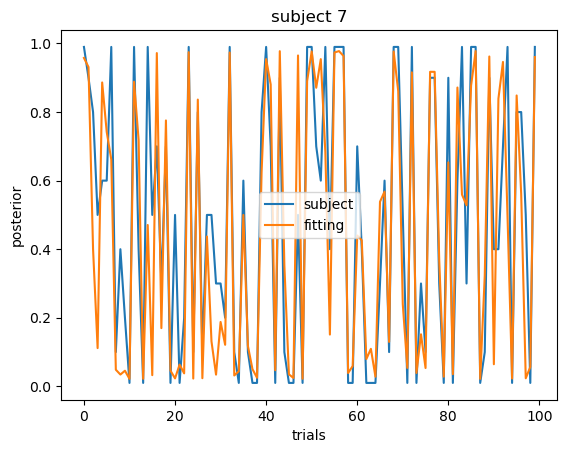

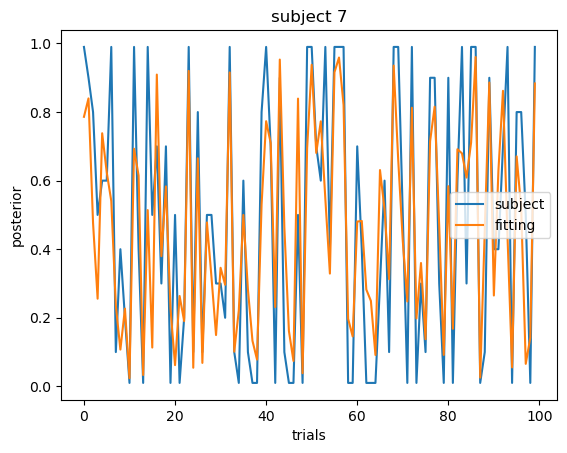

22:30:22 - cmdstanpy - INFO - CmdStan start processing


8


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 3 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 1 |██████▉      


22:30:25 - cmdstanpy - INFO - CmdStan done processing.


22:30:25 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 2 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |█████                   | 00:00 Iteratio


22:30:28 - cmdstanpy - INFO - CmdStan done processing.


22:30:28 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |██▋                     | 00:00 Iterati


22:30:34 - cmdstanpy - INFO - CmdStan done processing.


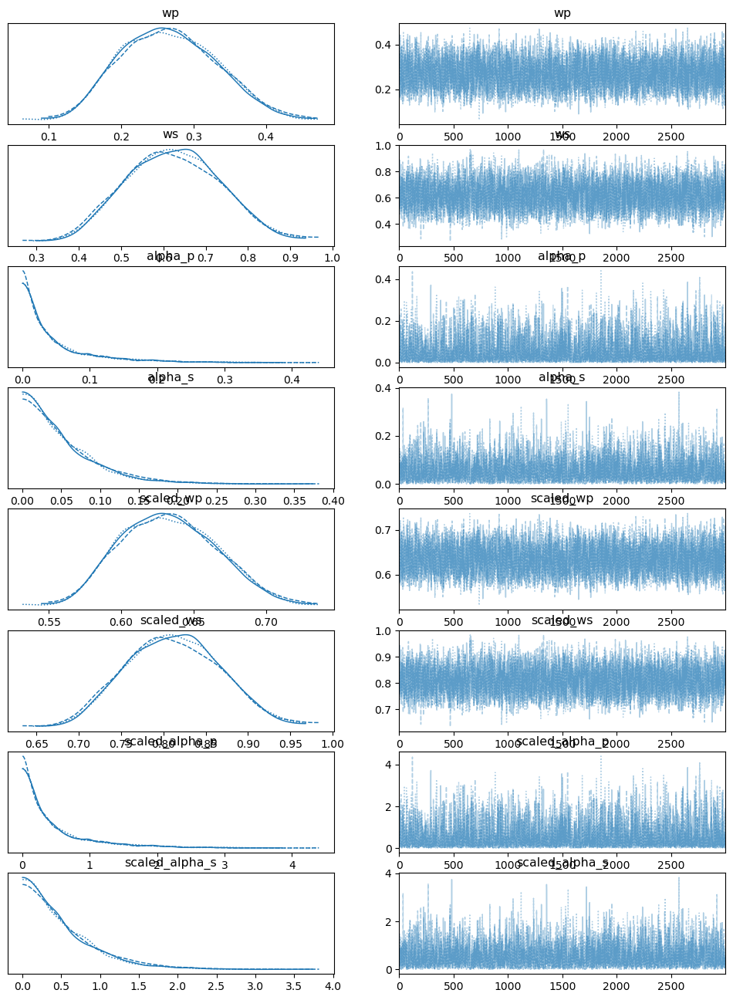

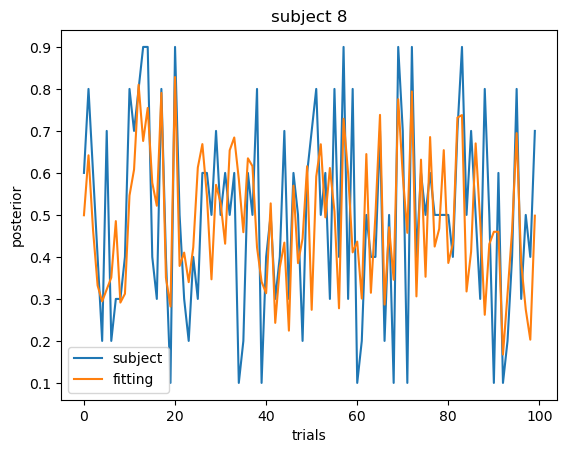

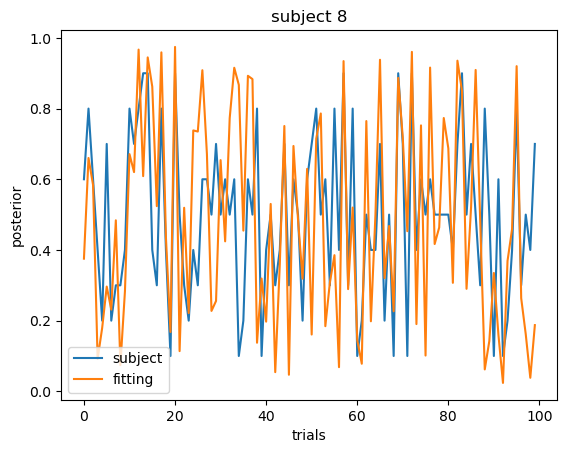

22:30:35 - cmdstanpy - INFO - CmdStan start processing


9


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 3 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 1 |██████▉      


22:30:38 - cmdstanpy - INFO - CmdStan done processing.


22:30:39 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteratio


22:30:42 - cmdstanpy - INFO - CmdStan done processing.


22:30:42 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 3 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 1 |███                     | 00:00 Iterati


22:30:50 - cmdstanpy - INFO - CmdStan done processing.


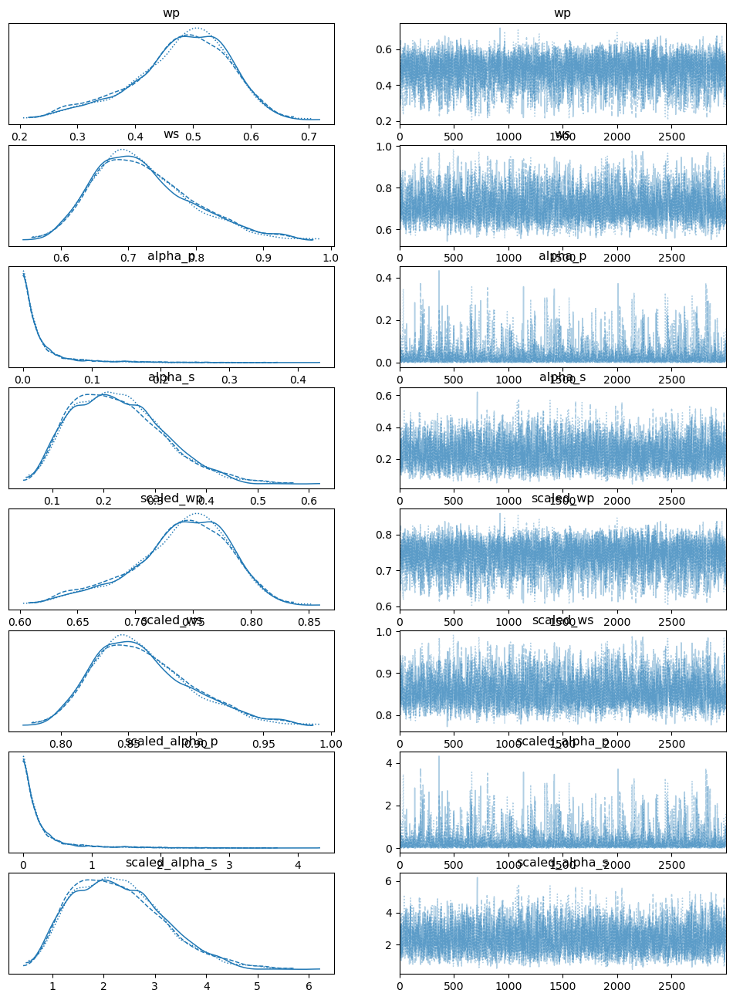

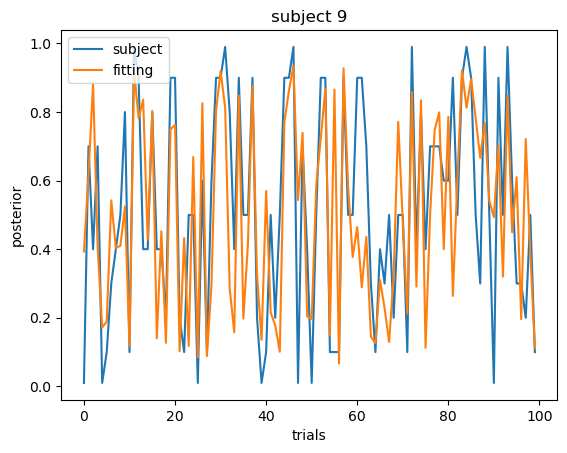

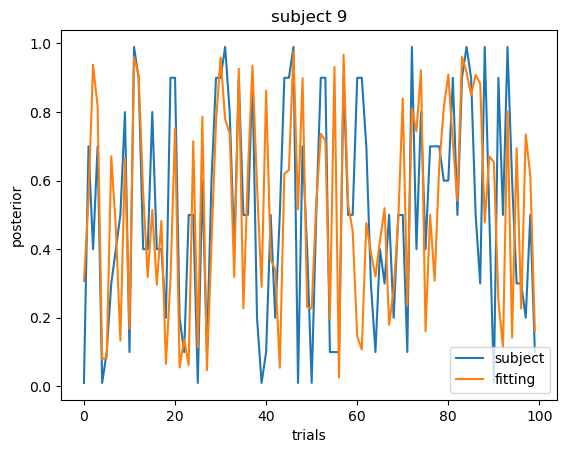

22:30:51 - cmdstanpy - INFO - CmdStan start processing


10


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 1 |█████▊       


22:30:54 - cmdstanpy - INFO - CmdStan done processing.


22:30:55 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 3 |███▊                    | 00:00 Iterati


22:30:59 - cmdstanpy - INFO - CmdStan done processing.


22:30:59 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 2 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteratio


22:31:06 - cmdstanpy - INFO - CmdStan done processing.


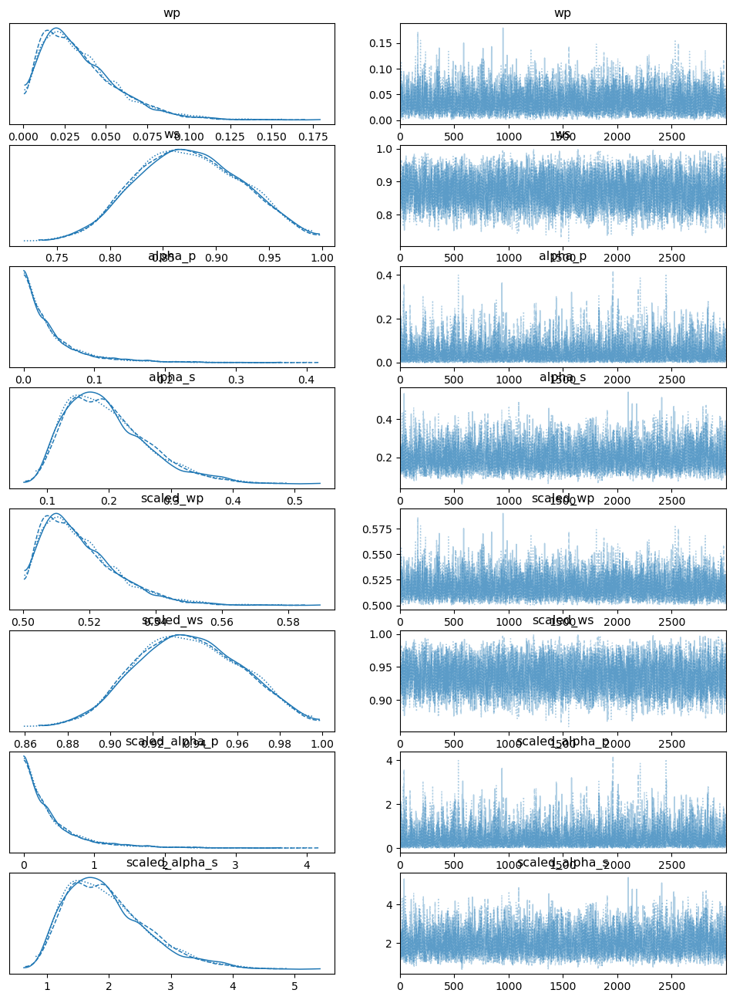

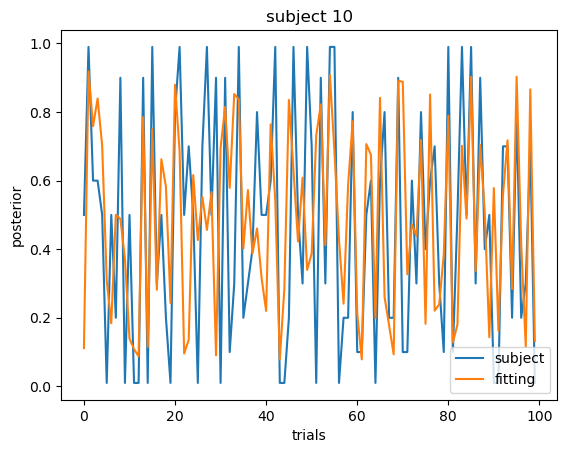

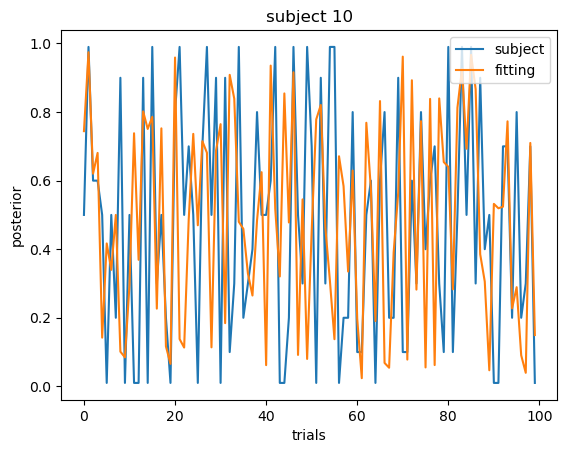

22:31:07 - cmdstanpy - INFO - CmdStan start processing


11


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 2 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 1 |█████▊       


22:31:11 - cmdstanpy - INFO - CmdStan done processing.


22:31:11 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 2 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteratio


22:31:15 - cmdstanpy - INFO - CmdStan done processing.


22:31:16 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███▊                    | 00:00 Iteratio


22:31:21 - cmdstanpy - INFO - CmdStan done processing.


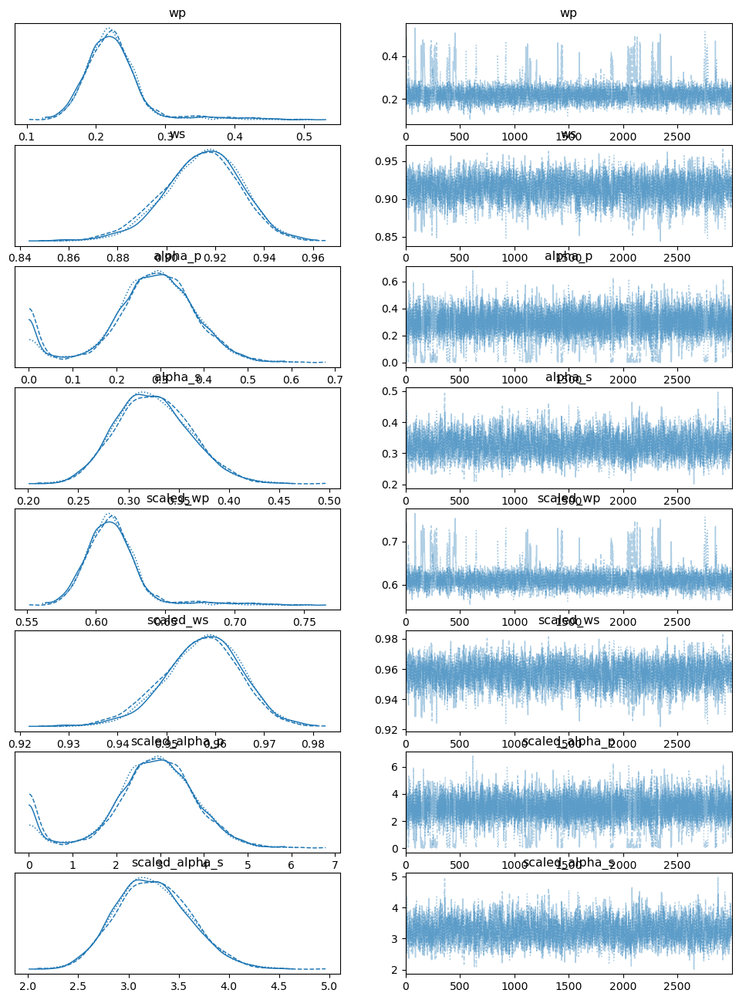

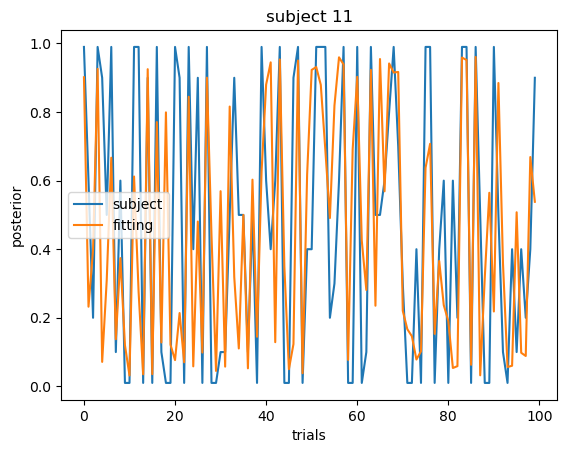

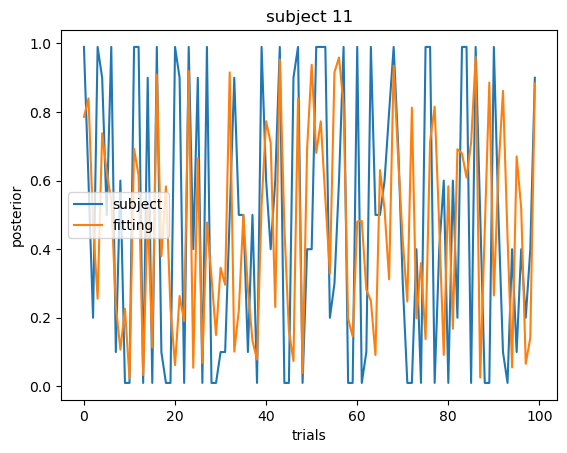

22:31:22 - cmdstanpy - INFO - CmdStan start processing


12


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 2 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 1 |██████▉      


22:31:25 - cmdstanpy - INFO - CmdStan done processing.


22:31:26 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 1 |████▎                   | 00:00 Iteration:  900 / 6000 [ 15%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |█████▍                  | 00:00 Iteration


22:31:30 - cmdstanpy - INFO - CmdStan done processing.


22:31:30 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▊                    | 00:00 Iterati


22:31:35 - cmdstanpy - INFO - CmdStan done processing.


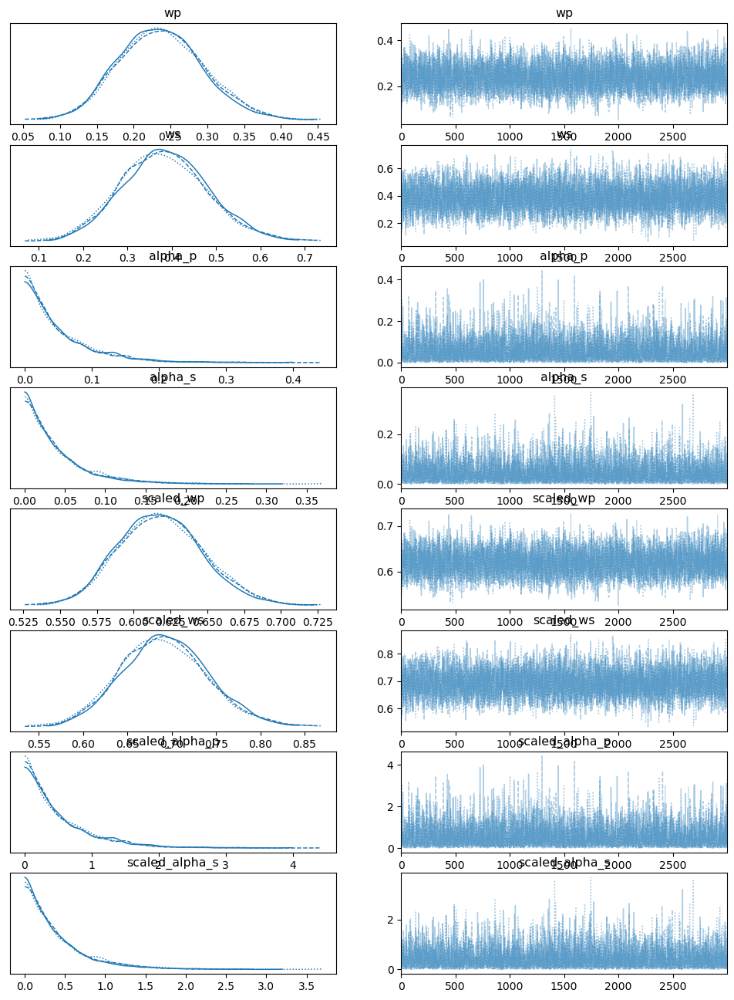

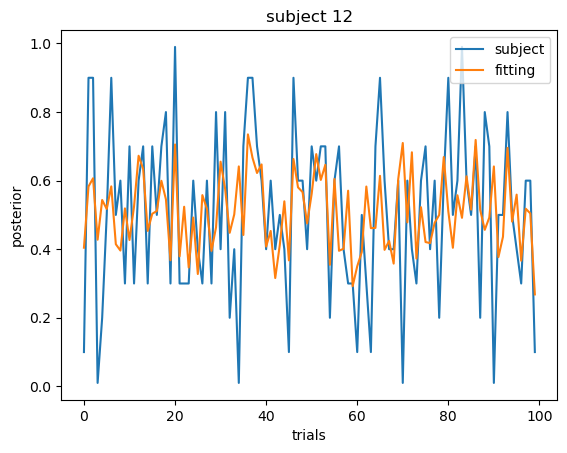

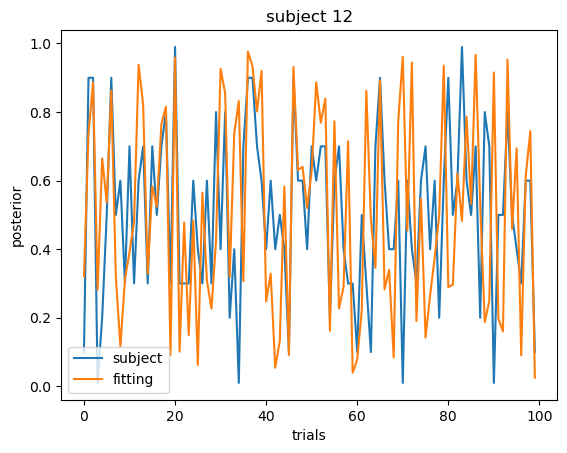

22:31:36 - cmdstanpy - INFO - CmdStan start processing


13


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 3 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 1 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 3 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 1 |█████                   | 00:00 Iteration: 1100 / 6000 [ 18%]  (Warmup)

chain 3 |█████        

22:31:39 - cmdstanpy - INFO - CmdStan done processing.


22:31:40 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 1 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 3 |███▊                    | 00:00 Iterati


22:31:43 - cmdstanpy - INFO - CmdStan done processing.


22:31:44 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 2 |███▊                    | 00:01 Iteratio


22:31:51 - cmdstanpy - INFO - CmdStan done processing.


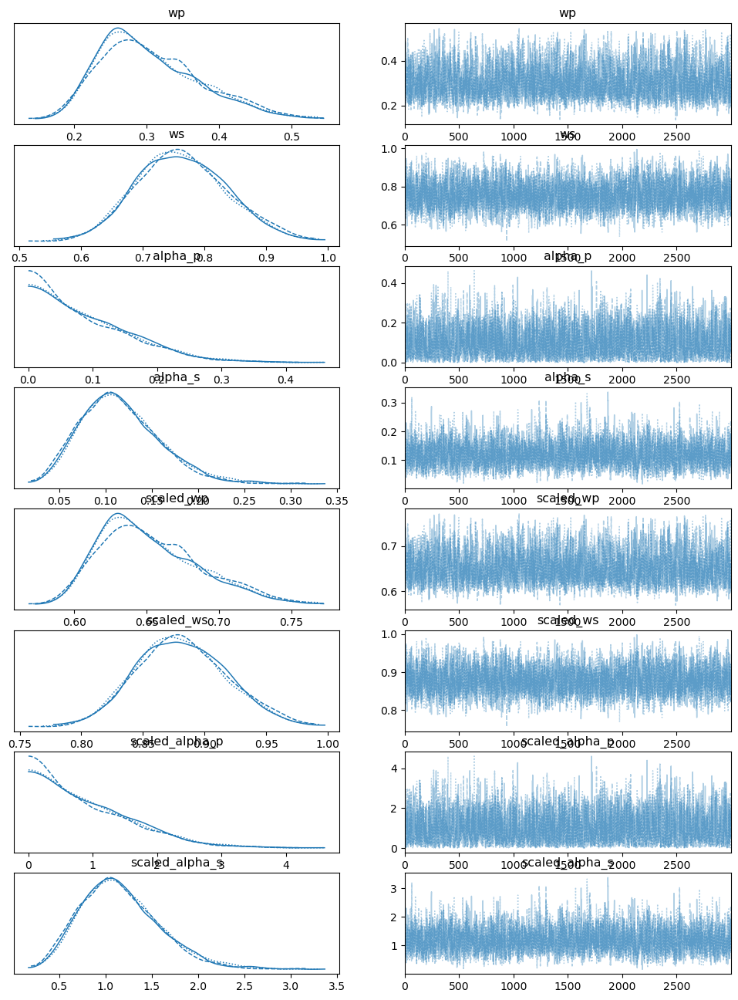

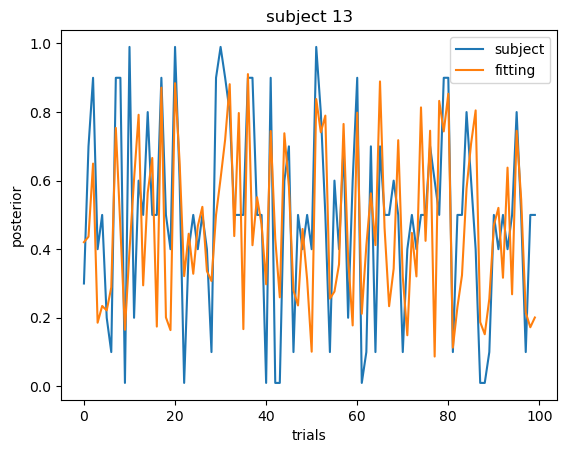

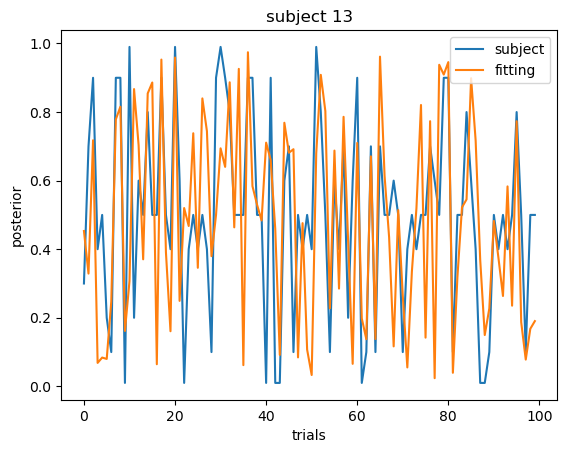

22:31:52 - cmdstanpy - INFO - CmdStan start processing


14


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |████▎                   | 00:00 Iteration:  900 / 6000 [ 15%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |█████▍                  | 00:00 Iteration: 1200 / 6000 [ 20%]  (Warmup)
chain 1 |█████▊       


22:31:55 - cmdstanpy - INFO - CmdStan done processing.


22:31:56 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███                     | 00:00 Iteratio


22:31:59 - cmdstanpy - INFO - CmdStan done processing.


22:32:00 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▊                    | 00:00 Iterati


22:32:06 - cmdstanpy - INFO - CmdStan done processing.


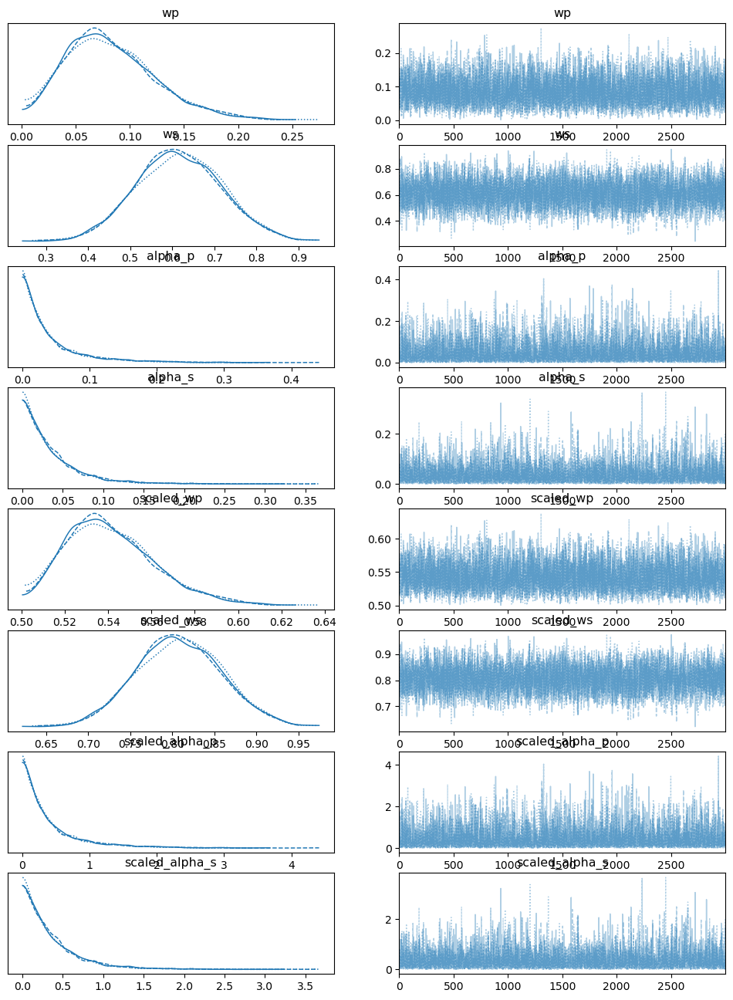

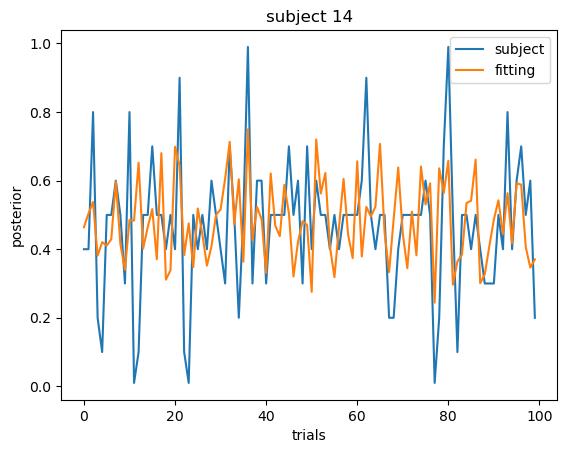

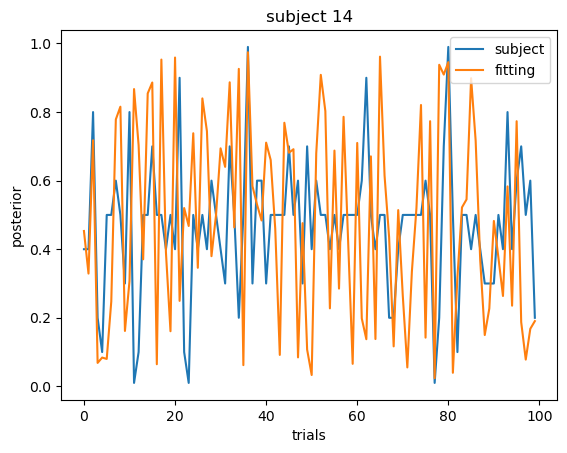

22:32:07 - cmdstanpy - INFO - CmdStan start processing


15


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |█████                   | 00:00 Iteration: 1100 / 6000 [ 18%]  (Warmup)
chain 1 |█████▊       


22:32:10 - cmdstanpy - INFO - CmdStan done processing.


22:32:10 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▊                    | 00:00 Iterati


22:32:14 - cmdstanpy - INFO - CmdStan done processing.


22:32:14 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 3 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteratio


22:32:23 - cmdstanpy - INFO - CmdStan done processing.


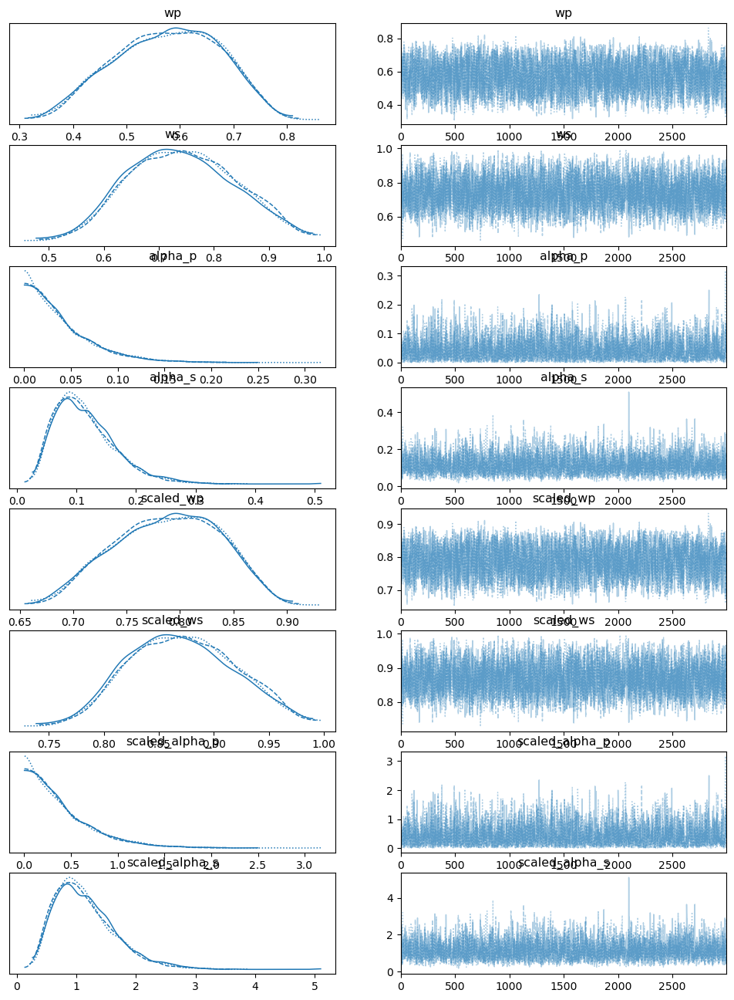

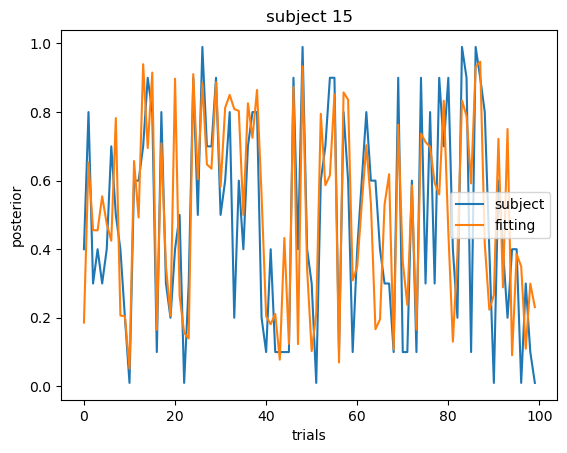

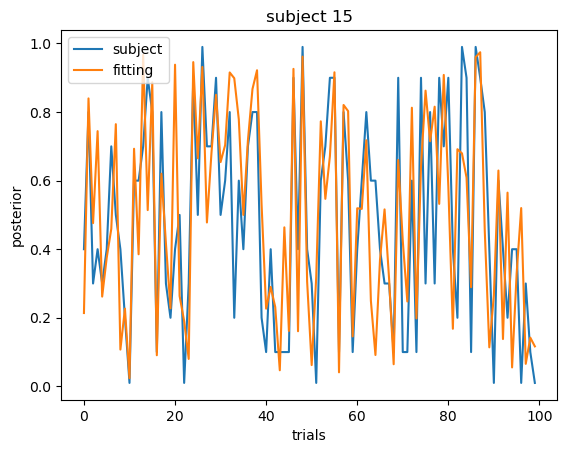

22:32:24 - cmdstanpy - INFO - CmdStan start processing


16


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 2 |█████▊       


22:32:27 - cmdstanpy - INFO - CmdStan done processing.


22:32:28 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)

chain 3 |███▊                    | 00:00 Iterati


22:32:31 - cmdstanpy - INFO - CmdStan done processing.


22:32:31 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 3 |██▎                     | 00:00 Iterati


22:32:38 - cmdstanpy - INFO - CmdStan done processing.


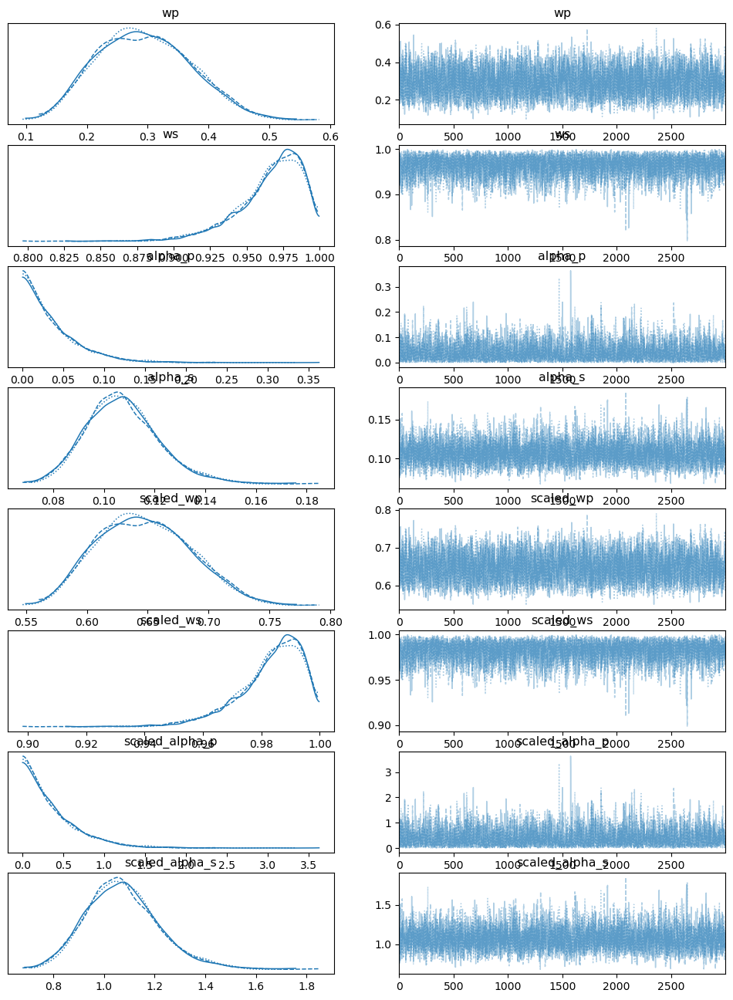

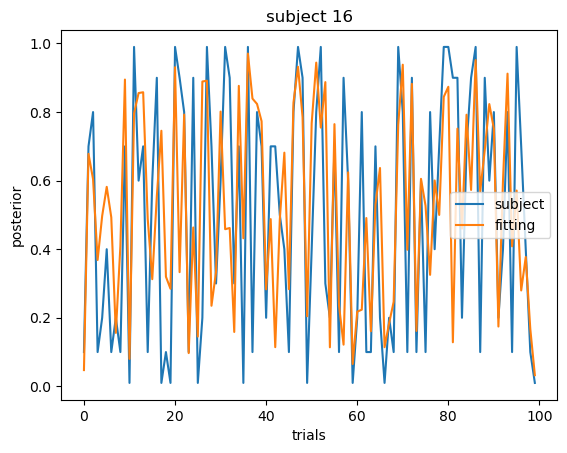

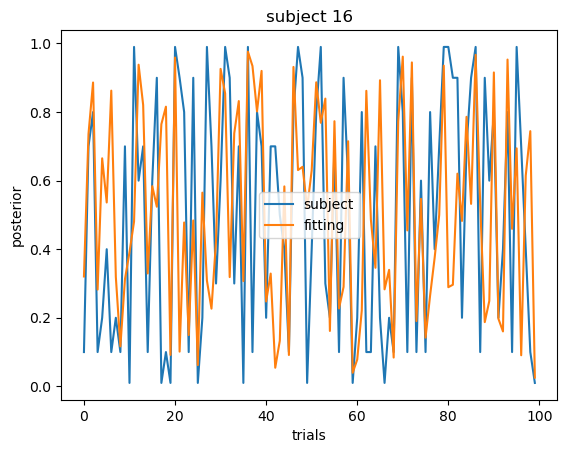

22:32:39 - cmdstanpy - INFO - CmdStan start processing


17


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 2 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 1 |██████▉      


22:32:42 - cmdstanpy - INFO - CmdStan done processing.


22:32:43 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |███▊                    | 00:00 Iterati


22:32:47 - cmdstanpy - INFO - CmdStan done processing.


22:32:47 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▎                     | 00:01 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▋                     | 00:01 Iterati


22:32:59 - cmdstanpy - INFO - CmdStan done processing.


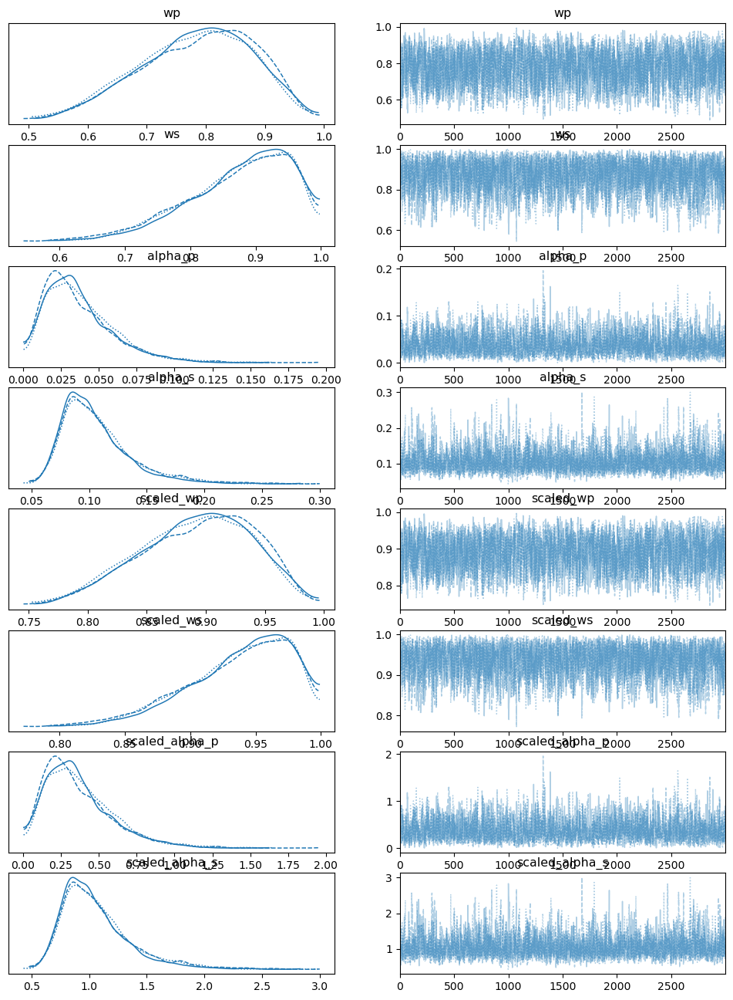

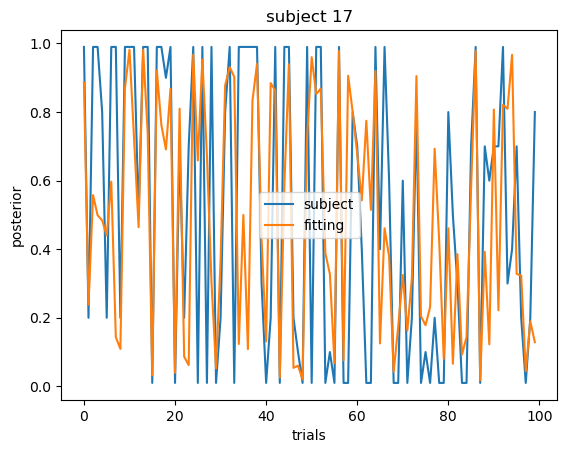

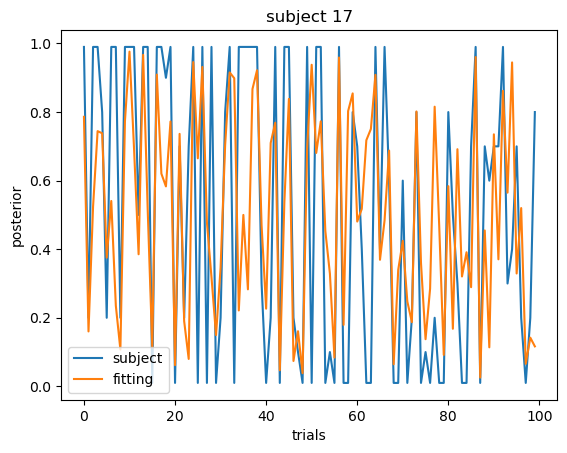

22:33:00 - cmdstanpy - INFO - CmdStan start processing


18


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)
chain 2 |█████▊       


22:33:03 - cmdstanpy - INFO - CmdStan done processing.


22:33:03 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 3 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███▊                    | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)
chain 2 |████▎                   | 00:00 Iteratio


22:33:07 - cmdstanpy - INFO - CmdStan done processing.


22:33:08 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 3 |███                     | 00:00 Iterati


22:33:15 - cmdstanpy - INFO - CmdStan done processing.


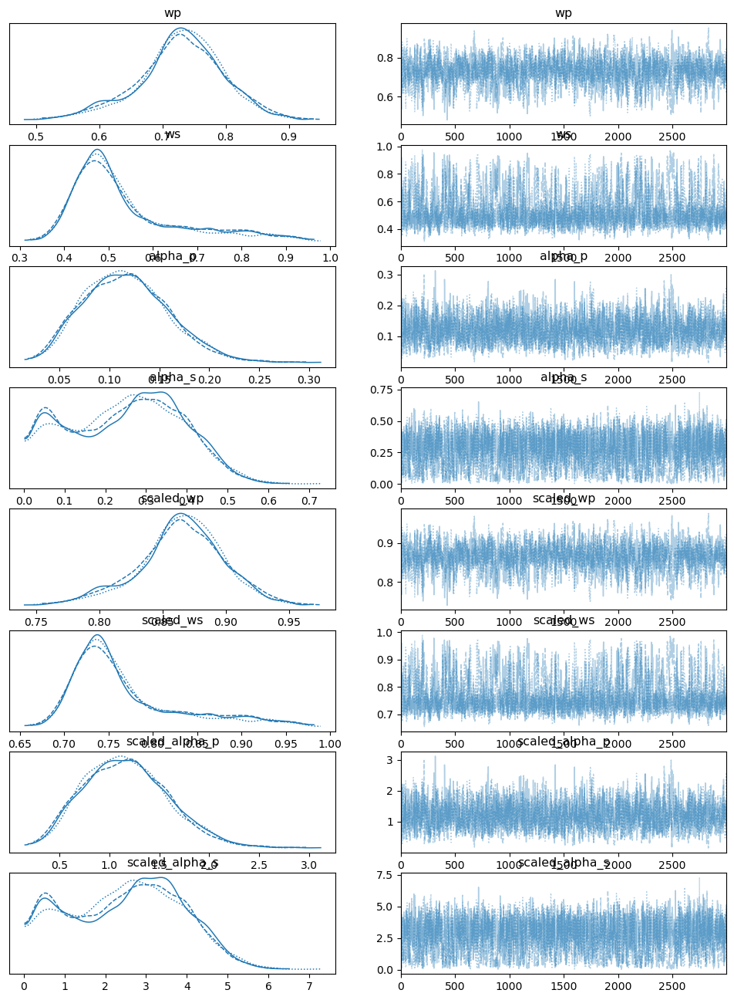

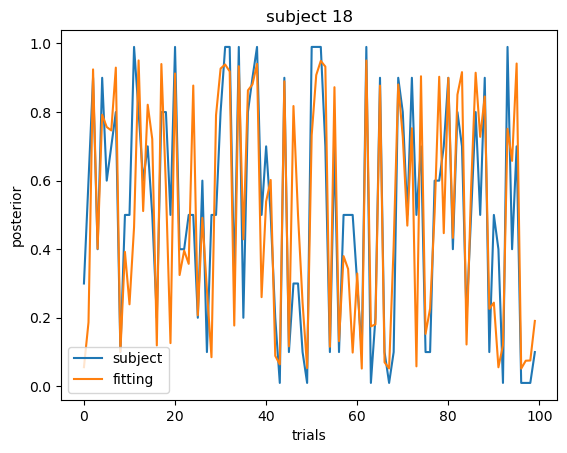

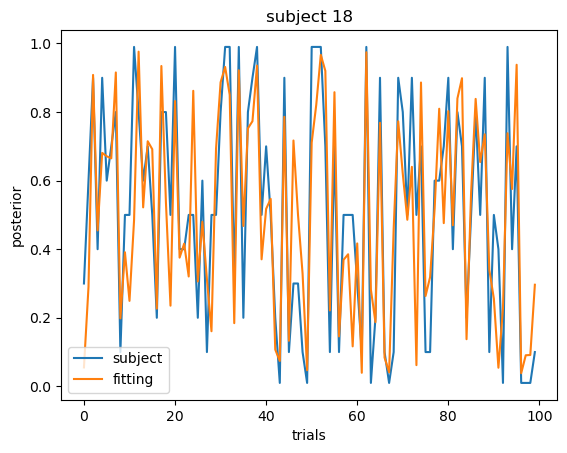

22:33:16 - cmdstanpy - INFO - CmdStan start processing


19


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 3 |████▎                   | 00:00 Iteration:  900 / 6000 [ 15%]  (Warmup)
chain 1 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 3 |█████▍                  | 00:00 Iteration: 1200 / 6000 [ 20%]  (Warmup)
chain 1 |██████▉      


22:33:19 - cmdstanpy - INFO - CmdStan done processing.


22:33:20 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███▊                    | 00:00 Iteratio


22:33:23 - cmdstanpy - INFO - CmdStan done processing.


22:33:23 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)
chain 2 |██▋                     | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)

chain 1 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 2 |███                     | 00:00 Iteratio


22:33:30 - cmdstanpy - INFO - CmdStan done processing.


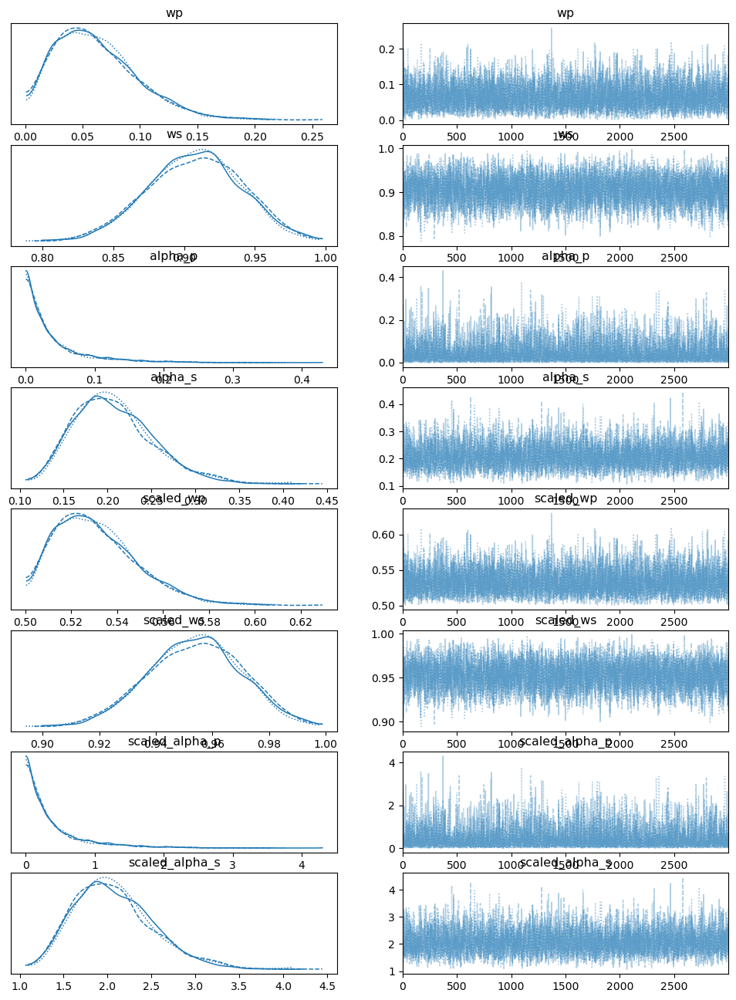

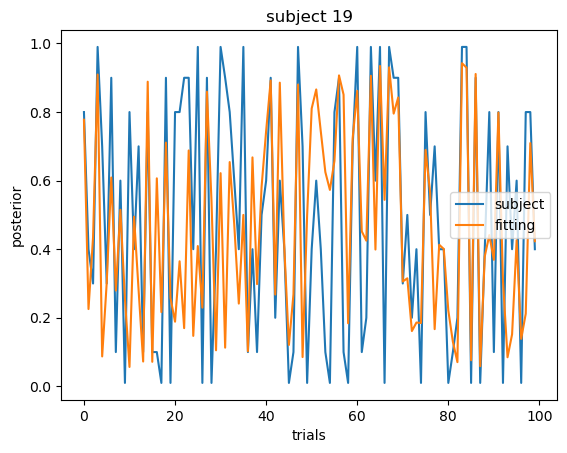

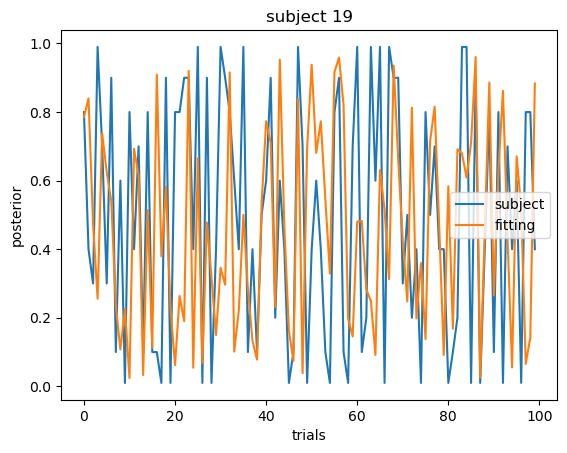

22:33:31 - cmdstanpy - INFO - CmdStan start processing


20


chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status
chain 2 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)

chain 1 |█▏                      | 00:00 Iteration:  100 / 6000 [  1%]  (Warmup)
chain 2 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)
chain 2 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)

chain 1 |████▋                   | 00:00 Iteration: 1000 / 6000 [ 16%]  (Warmup)
chain 2 |█████▊                  | 00:00 Iteration: 1300 / 6000 [ 21%]  (Warmup)

chain 1 |█████▊       


22:33:34 - cmdstanpy - INFO - CmdStan done processing.


22:33:34 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 3 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 2 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)

chain 3 |███                     | 00:00 Iteration:  600 / 6000 [ 10%]  (Warmup)
chain 1 |███▍                    | 00:00 Iteration:  700 / 6000 [ 11%]  (Warmup)

chain 3 |███▊                    | 00:00 Iterati


22:33:38 - cmdstanpy - INFO - CmdStan done processing.


22:33:38 - cmdstanpy - INFO - CmdStan start processing
chain 1 |                                                         | 00:00 Status
chain 2 |                                                         | 00:00 Status

chain 1 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)

chain 3 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 2 |▊                       | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)
chain 1 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)

chain 3 |█▌                      | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)
chain 1 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 1 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 2 |█▉                      | 00:00 Iteration:  300 / 6000 [  5%]  (Warmup)

chain 3 |██▎                     | 00:00 Iteration:  400 / 6000 [  6%]  (Warmup)
chain 1 |██▋                     | 00:00 Iteratio


22:33:49 - cmdstanpy - INFO - CmdStan done processing.


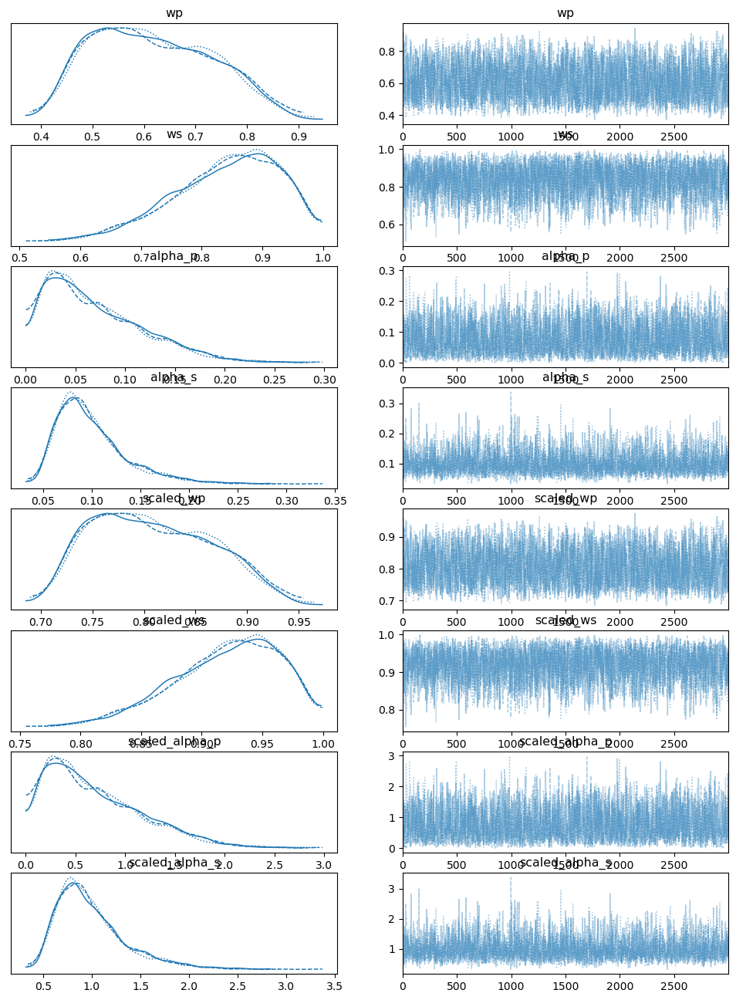

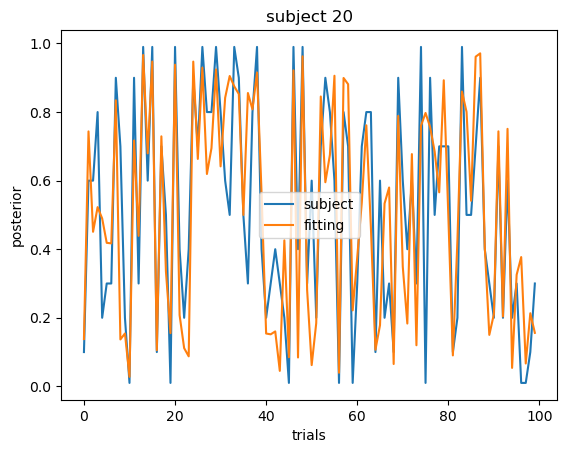

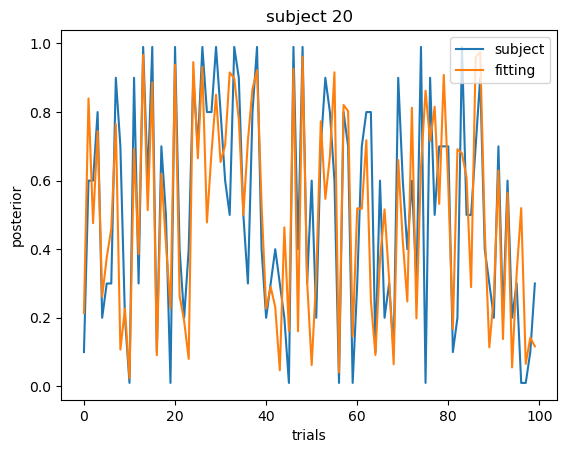

In [11]:
for sub in range(number_sub):
    print(sub)
    sub_data = data[data['subject']==sub]
    prior_list = np.zeros(100)
    right_likelihood_list = np.zeros(100)
    left_likelihood_list = np.zeros(100)
    c_list = np.zeros(100)

    for trial in range(100):
        prior_list[trial] = sub_data.at[(100*sub)+trial,'prior']

        #Likelihood depends on corloc
        if sub_data.at[(100*sub)+trial,'corloc']==1:
            left_likelihood_list[trial] = sub_data.at[(100*sub)+trial,'correct_image']
            right_likelihood_list[trial] = sub_data.at[(100*sub)+trial,'false_image']
        elif sub_data.at[(100*sub)+trial,'corloc']==2:
            left_likelihood_list[trial] = sub_data.at[(100*sub)+trial,'false_image']
            right_likelihood_list[trial] = sub_data.at[(100*sub)+trial,'correct_image']

        c_list[trial] = sub_data.at[(100*sub)+trial,'posterior']

    prior_list = [n/100 for n in prior_list]
    left_like_list = [n/100 for n in left_likelihood_list]
    right_like_list = [n/100 for n in right_likelihood_list]

    c_list = [1 if c==0 else c for c in c_list]
    c_list = [99 if c==100 else c for c in c_list]
    c_list = [n/100 for n in c_list]

    # simple Bayes
    bic_simple, sigma_squared_simple = compute_BIC(c_list,prior_list,left_like_list,right_like_list,[1,1,0,0],0)
    
    bic_matrix.iloc[sub,0] = bic_simple
    sigma_matrix.iloc[sub,0] = sigma_squared_simple

    stan_data = {"T":100,"prior":prior_list ,"left_likelihood":left_like_list,"right_likelihood":right_like_list,"confidence":c_list,"scale_p":scale_p,"scale_s":scale_s}
    # Weighted Bayes
    sm_weight = CmdStanModel(stan_file="model_weighted.stan")
    fit_weight = sm_weight.sample(data=stan_data,chains=3, iter_sampling=3000,iter_warmup=3000, adapt_delta=0.9)
    idata_we   = az.from_cmdstanpy(posterior=fit_weight,log_likelihood="log_lik",observed_data={"confidence": c_list})
    summary_we = az.summary(idata_we)
    para_wei = [summary_we.loc['wp', 'mean'],summary_we.loc['ws', 'mean'],0,0]
    bic_weight, sigma_squared_weight = compute_BIC(c_list,prior_list,left_like_list,right_like_list,para_wei,2)
    bic_matrix.iloc[sub,1] = bic_weight
    sigma_matrix.iloc[sub,1] = sigma_squared_weight

    
    sm_alpha = CmdStanModel(stan_file="model_alpha.stan")
    fit_alpha = sm_alpha.sample(data=stan_data,chains=3, iter_sampling=3000,iter_warmup=3000, adapt_delta=0.9)
    idata_al   = az.from_cmdstanpy(posterior=fit_alpha,log_likelihood="log_lik",observed_data={"confidence": c_list})
    summary_al = az.summary(idata_al)
    para_alp = [1,1,summary_al.loc['scaled_alpha_p', 'mean'],summary_al.loc['scaled_alpha_s', 'mean']]
    bic_alpha, sigma_squared_alpha = compute_BIC(c_list,prior_list,left_like_list,right_like_list,para_alp,2)
    bic_matrix.iloc[sub,2] = bic_alpha
    sigma_matrix.iloc[sub,2] = sigma_squared_alpha

    
    sm_circular = CmdStanModel(stan_file="model_circular.stan")
    fit_circular = sm_circular.sample(data=stan_data,chains=3, iter_sampling=3000,iter_warmup=3000, adapt_delta=0.9)
    idata_ci   = az.from_cmdstanpy(posterior=fit_circular,log_likelihood="log_lik",observed_data={"confidence": c_list})
    summary_ci = az.summary(idata_ci)
    para_cir = [summary_ci.loc['wp', 'mean'],summary_ci.loc['ws', 'mean'],summary_ci.loc['scaled_alpha_p', 'mean'],summary_ci.loc['scaled_alpha_s', 'mean']]
    bic_circular, sigma_squared_circular = compute_BIC(c_list,prior_list,left_like_list,right_like_list,para_cir,4)
    bic_matrix.iloc[sub,3] = bic_circular
    sigma_matrix.iloc[sub,3] = sigma_squared_circular

    az.plot_trace(fit_circular)
    plt.show()

    # take parameters
    weighted_matrix.iloc[sub,0] = summary_we.loc['wp','mean']
    weighted_matrix.iloc[sub,1] = summary_we.loc['ws','mean']

    
    alpha_matrix.iloc[sub,0] = summary_al.loc['alpha_p','mean']
    alpha_matrix.iloc[sub,1] = summary_al.loc['alpha_s','mean']

    circular_matrix.iloc[sub,0] = summary_ci.loc['wp','mean']
    circular_matrix.iloc[sub,1] = summary_ci.loc['ws','mean']
    circular_matrix.iloc[sub,2] = summary_ci.loc['alpha_p','mean']
    circular_matrix.iloc[sub,3] = summary_ci.loc['alpha_s','mean']

    estimated = np.zeros(100)
    estimated_sim = np.zeros(100)
    for t in range(100):
        estimated[t] = circular_inference(prior_list[t],left_like_list[t],right_like_list[t],para_cir)
        estimated_sim[t] = circular_inference(prior_list[t],left_like_list[t],right_like_list[t],[1,1,0,0])
    
    plt.plot(c_list,label='subject')
    plt.plot(estimated,label='fitting')
    plt.ylabel('posterior')
    plt.xlabel('trials')
    plt.title(f'subject {sub}')
    plt.legend()
    plt.show()

    plt.plot(c_list,label='subject')
    plt.plot(estimated_sim,label='fitting')
    plt.ylabel('posterior')
    plt.xlabel('trials')
    plt.title(f'subject {sub}')
    plt.legend()
    plt.show()

In [12]:
df_all

,values,parameters,subject,subject_ID,group
0,0.865,wp,0.0,DI,scz
1,0.131,ws,0.0,DI,scz
2,0.246,alpha_p,0.0,DI,scz
3,0.402,alpha_s,0.0,DI,scz
4,0.294,wp,1.0,HM,scz
...,...,...,...,...,...
79,2.073,alpha_s,19.0,MYa,con
80,0.613,wp,20.0,HK,con
81,0.842,ws,20.0,HK,con
82,0.719,alpha_p,20.0,HK,con


/var/folders/r8/tmdrdy8s6kvbrfztj7r8k3qr0000gr/T/ipykernel_13425/209101832.py:20: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 68)` for the same effect.

  sns.catplot(data=df_all,x='parameters',y='values', kind='bar',hue='group',ci=68)


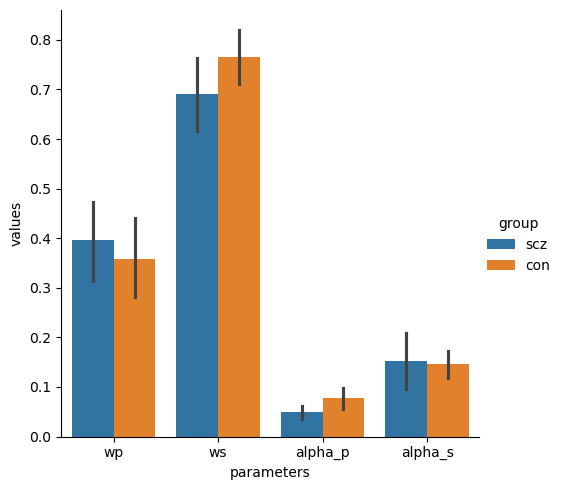

In [13]:
# subsub = list(itertools.chain.from_iterable(allsub))
df_all = pd.DataFrame(list(itertools.chain.from_iterable(circular_matrix.values)),columns=['values'])
df_all['parameters'] = 'a'
subject_ID = ['DI', 'HM', 'RM', 'KH', 'MF', 'MOt','FA', 'KT', 'SY', 'TY',
              'MN', 'NK', 'SK', 'NKu','MY', 'YA', 'TK', 'TN', 'HH', 'MYa', 'HK']

for i in range(21):
    df_all.iat[4*i,1] = 'wp'
    df_all.iat[4*i+1,1] = "ws"
    df_all.iat[4*i+2,1] = 'alpha_p'
    df_all.iat[4*i+3,1] = "alpha_s"
    # df_all.iat[4*i+4,1] = "alpha_p+s"
    
    df_all.loc[4*i:4*i+3, 'subject'] = i
    df_all.loc[4*i:4*i+3, 'subject_ID'] = subject_ID[i]

df_all.loc[0:39,'group'] = 'scz'
df_all.loc[40:83,'group'] = 'con'

sns.catplot(data=df_all,x='parameters',y='values', kind='bar',hue='group',ci=68)
plt.show()

4863.363812237388 3895.7047376080695 4685.2009059117045 3967.7622627529518
4743.602978971381 3699.747374441584 4576.86794833703 3739.0031614977306
4966.610815527679 4056.6304735778554 4776.349381283763 4150.912693463123


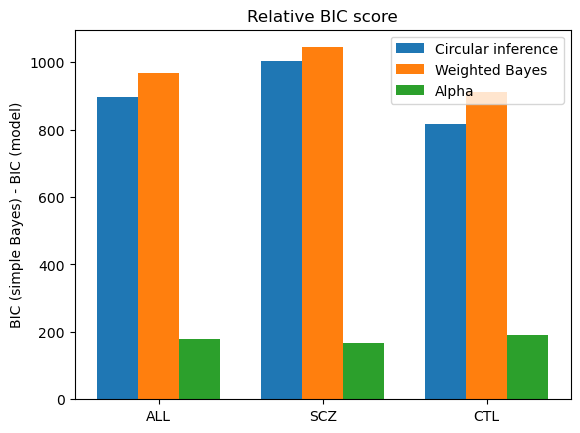

In [14]:
# BIC all subjects

BIC_simple_all = 100*21*np.log(sum(sigma_matrix['Simple'])/21) + 0*np.log(100*21)
BIC_weighted_all = 100*21*np.log(sum(sigma_matrix['Weighted'])/21) + 2*np.log(100*21)
BIC_alpha_all = 100*21*np.log(sum(sigma_matrix['Alpha'])/21) + 2*np.log(100*21)
BIC_circular_all = 100*21*np.log(sum(sigma_matrix['Circular'])/21) + 4*np.log(100*21)
print(BIC_simple_all,BIC_weighted_all,BIC_alpha_all,BIC_circular_all)

BIC_simple_scz = 100*21*np.log(sum(sigma_matrix['Simple'][:10])/10) + 0*np.log(100*10)
BIC_weighted_scz = 100*21*np.log(sum(sigma_matrix['Weighted'][:10])/10) + 2*np.log(100*10)
BIC_alpha_scz = 100*21*np.log(sum(sigma_matrix['Alpha'][:10])/10) + 2*np.log(100*10)
BIC_circular_scz = 100*21*np.log(sum(sigma_matrix['Circular'][:10])/10) + 4*np.log(100*10)
print(BIC_simple_scz,BIC_weighted_scz,BIC_alpha_scz,BIC_circular_scz)

BIC_simple_con = 100*21*np.log(sum(sigma_matrix['Simple'][10:])/11) + 0*np.log(100*10)
BIC_weighted_con = 100*21*np.log(sum(sigma_matrix['Weighted'][10:])/11) + 2*np.log(100*10)
BIC_alpha_con = 100*21*np.log(sum(sigma_matrix['Alpha'][10:])/11) + 2*np.log(100*10)
BIC_circular_con = 100*21*np.log(sum(sigma_matrix['Circular'][10:])/11) + 4*np.log(100*10)
print(BIC_simple_con,BIC_weighted_con,BIC_alpha_con,BIC_circular_con)

relativeBIC_circular_all = BIC_simple_all - BIC_circular_all
relativeBIC_weight_all = BIC_simple_all - BIC_weighted_all
relativeBIC_alpha_all = BIC_simple_all - BIC_alpha_all

relativeBIC_circular_scz = BIC_simple_scz - BIC_circular_scz
relativeBIC_weight_scz = BIC_simple_scz - BIC_weighted_scz
relativeBIC_alpha_scz = BIC_simple_scz - BIC_alpha_scz

relativeBIC_circular_con = BIC_simple_con - BIC_circular_con
relativeBIC_weight_con = BIC_simple_con - BIC_weighted_con
relativeBIC_alpha_con = BIC_simple_con - BIC_alpha_con

labels = ['ALL', 'SCZ', 'CTL']
circular_means = [relativeBIC_circular_all, relativeBIC_circular_scz, relativeBIC_circular_con]
weight_means = [relativeBIC_weight_all, relativeBIC_weight_scz, relativeBIC_weight_con]
alpha_means = [relativeBIC_alpha_all, relativeBIC_alpha_scz, relativeBIC_alpha_con]

x = np.arange(len(labels))  # the label locations
width = 0.25  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width, circular_means, width, label='Circular inference')
rects2 = ax.bar(x, weight_means, width, label='Weighted Bayes')
rects2 = ax.bar(x + width, alpha_means, width, label='Alpha')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('BIC (simple Bayes) - BIC (model)')
ax.set_title('Relative BIC score')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()